# WELCOME!

Welcome to "***Employee Churn Analysis Project***". In this project, we will be able to build our own classification models for a variety of business settings. 

Also we will learn what is Employee Churn, how it is different from customer churn, exploratory data analysis and visualization of employee churn dataset using ***matplotlib*** and ***seaborn***, model building and evaluation using python ***scikit-learn*** package. 

We will be able to implement classification techniques in Python. Using Scikit-Learn allowing you to successfully make predictions with the Random Forest, Gradient Descent Boosting , KNN algorithms.

At the end of the project, we will have the opportunity to deploy your model using *Streamlit*.

Before diving into the project, please take a look at the determines and project structure.

# #Determines
In this project we have HR data of a company. A study is requested from us to predict which employee will churn by using this data.

The HR dataset has 14,999 samples. In the given dataset, we have two types of employee one who stayed and another who left the company.

We can describe 10 attributes in detail as:
- ***satisfaction_level:*** It is employee satisfaction point, which ranges from 0-1.
- ***last_evaluation:*** It is evaluated performance by the employer, which also ranges from 0-1.
- ***number_projects:*** How many of projects assigned to an employee?
- ***average_monthly_hours:*** How many hours in averega an employee worked in a month?
- **time_spent_company:** time_spent_company means employee experience. The number of years spent by an employee in the company.
- ***work_accident:*** Whether an employee has had a work accident or not.
- ***promotion_last_5years:*** Whether an employee has had a promotion in the last 5 years or not.
- ***Departments:*** Employee's working department/division.
- ***Salary:*** Salary level of the employee such as low, medium and high.
- ***left:*** Whether the employee has left the company or not.

First of all, to observe the structure of the data, outliers, missing values and features that affect the target variable, we must use exploratory data analysis and data visualization techniques. 

Then, we must perform data pre-processing operations such as ***Scaling*** and ***Label Encoding*** to increase the accuracy score of Gradient Descent Based or Distance-Based algorithms. We are asked to perform ***Cluster Analysis*** based on the information we obtain during exploratory data analysis and data visualization processes. 

The purpose of clustering analysis is to cluster data with similar characteristics. We are asked to use the ***K-means*** algorithm to make cluster analysis. However, we must provide the K-means algorithm with information about the number of clusters it will make predictions. Also, the data we apply to the K-means algorithm must be scaled. In order to find the optimal number of clusters, we are asked to use the ***Elbow method***. Briefly, we try to predict the set to which individuals are related by using K-means and evaluate the estimation results.

Once the data is ready to be applied to the model, we must ***split the data into train and test***. Then we will build a model to predict whether employees will churn or not. We will trainyour models with our train set, test the success of our model with our test set. 

We will try to make your predictions by using the algorithms ***Gradient Boosting Classifier***, ***K Neighbors Classifier***, ***Random Forest Classifier***. We can use the related modules of the ***scikit-learn*** library. WeYou can use scikit-learn ***Confusion Metrics*** module for accuracy calculation. We can use the ***Yellowbrick*** module for model selection and visualization.

In the final step, we will deploy our model using Streamlit tool.



# #Tasks

#### 1. Exploratory Data Analysis
- Importing Modules
- Loading Dataset
- Data Insigts

#### 2. Data Visualization
- Employees Left
- Determine Number of Projects
- Determine Time Spent in Company
- Subplots of Features

#### 3. Data Pre-Processing
- Scaling
- Label Encoding

#### 4. Cluster Analysis
- Find the optimal number of clusters (k) using the elbow method for for K-means.
- Determine the clusters by using K-Means then Evaluate predicted results.

#### 5. Model Building
- Split Data as Train and Test set
- Built Gradient Boosting Classifier, Evaluate Model Performance and Predict Test Data
- Built K Neighbors Classifier and Evaluate Model Performance and Predict Test Data
- Built Random Forest Classifier and Evaluate Model Performance and Predict Test Data

#### 6. Model Deployement

- Save and Export the Model as .pkl
- Save and Export Variables as .pkl 

## 1. Exploratory Data Analysis

Exploratory Data Analysis is an initial process of analysis, in which we can summarize characteristics of data such as pattern, trends, outliers, and hypothesis testing using descriptive statistics and visualization.
___
- Importing Modules
- Loading Dataset
- Data Insigts

### Importing Modules

In [1]:
# 1-Import Libraies

#!pip install missingno
#!pip install pyforest
#!pip install cufflinks
#!pip install termcolor
##!pip install wordcloud
#!pip install squarify
#!pip install pyclustertend
#!pip install yellowbrick --user

In [3]:
# 1-Import Libraies
import numpy as np
import pandas as pd 
import seaborn as sns

import matplotlib.pyplot as plt
import plotly.express as px

import scipy.stats as stats
%matplotlib inline

import statsmodels.api as sm
import statsmodels.formula.api as smf
import missingno as msno 

import datetime as dt
from datetime import datetime

# Scaling
from sklearn.preprocessing import scale 
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import PolynomialFeatures 
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import PowerTransformer 
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import RobustScaler

# Importing plotly and cufflinks in offline mode
import cufflinks as cf
import plotly.offline
cf.go_offline()
cf.set_config_file(offline=False, world_readable=True)

# Ignore Warnings
import warnings
warnings.filterwarnings("ignore")
warnings.warn("this will not show")

# Figure&Display options
plt.rcParams["figure.figsize"] = (10,6)
pd.set_option('max_colwidth',200)
pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 200)
pd.set_option('display.float_format', lambda x: '%.3f' % x)

# makes strings colored
import colorama
from colorama import Fore, Style
from termcolor import colored
from termcolor import cprint

import ipywidgets
from ipywidgets import interact

# White grid plots for dark mode users
sns.set_style("whitegrid")



# Ignore Warnings
import warnings
warnings.filterwarnings("ignore")
warnings.warn("this will not show")

# Figure&Display options
plt.rcParams["figure.figsize"] = (10,6)
pd.set_option('max_colwidth',200)
pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 200)
pd.set_option('display.float_format', lambda x: '%.3f' % x)

In [13]:
## Some Useful Functions

###############################################################################

def missing_values(df):
    missing_number = df.isnull().sum().sort_values(ascending = False)
    missing_percent = (df.isnull().sum() / df.isnull().count()).sort_values(ascending = False)
    missing_values = pd.concat([missing_number, missing_percent], axis = 1, keys = ['Missing_Number', 'Missing_Percent'])
    return missing_values[missing_values['Missing_Number'] > 0]

###############################################################################

def first_looking(df):
    print(colored("Shape:", attrs=['bold']), df.shape,'\n', 
          colored('*'*100, 'red', attrs = ['bold']),
          colored("\nInfo:\n", attrs = ['bold']), sep = '')
    print(df.info(), '\n', 
          colored('*'*100, 'red', attrs = ['bold']), sep = '')
    print(colored("Number of Uniques:\n", attrs = ['bold']), df.nunique(),'\n',
          colored('*'*100, 'red', attrs = ['bold']), sep = '')
    print(colored("Missing Values:\n", attrs=['bold']), missing_values(df),'\n', 
          colored('*'*100, 'red', attrs = ['bold']), sep = '')
    print(colored("All Columns:", attrs = ['bold']), list(df.columns),'\n', 
          colored('*'*100, 'red', attrs = ['bold']), sep = '')

    df.columns = df.columns.str.lower().str.replace('&', '_').str.replace(' ', '_')
    print(colored("Columns after rename:", attrs = ['bold']), list(df.columns),'\n',
          colored('*'*100, 'red', attrs = ['bold']), sep = '')  
    print(colored("Columns after rename:", attrs = ['bold']), list(df.columns),'\n',
          colored('*'*100, 'red', attrs = ['bold']), sep = '')
    print(colored("Descriptive Statistics \n", attrs = ['bold']), df.describe().round(2),'\n',
          colored('*'*100, 'red', attrs = ['bold']), sep = '') # Gives a statstical breakdown of the data.
    print(colored("Descriptive Statistics (Categorical Columns) \n", attrs = ['bold']), df.describe(include = object).T,'\n',
          colored('*'*100, 'red', attrs = ['bold']), sep = '') # Gives a statstical breakdown of the data.
    
def multicolinearity_control(df):
    feature = []
    collinear = []
    for col in df.corr().columns:
        for i in df.corr().index:
            if (abs(df.corr()[col][i]) > .9 and abs(df.corr()[col][i]) < 1):
                    feature.append(col)
                    collinear.append(i)
                    print(colored(f"Multicolinearity alert in between:{col} - {i}", 
                                  "red", attrs = ['bold']), df.shape,'\n',
                                  colored('*'*100, 'red', attrs = ['bold']), sep = '')

def duplicate_values(df):
    print(colored("Duplicate check...", attrs = ['bold']), sep = '')
    print("There are", df.duplicated(subset = None, keep = 'first').sum(), "duplicated observations in the dataset.")
    duplicate_values = df.duplicated(subset = None, keep = 'first').sum()
    if duplicate_values > 0:
        df.drop_duplicates(keep = 'first', inplace = True)
        print(duplicate_values, colored(" Duplicates were dropped!"),'\n',
              colored('*'*100, 'red', attrs = ['bold']), sep = '')
#     else:
#         print(colored("There are no duplicates"),'\n',
#               colored('*'*100, 'red', attrs = ['bold']), sep = '')     
        
# def drop_columns(df, drop_columns):
#     if drop_columns != []:
#         df.drop(drop_columns, axis = 1, inplace = True)
#         print(drop_columns, 'were dropped')
#     else:
#         print(colored('We will now check the missing values and if necessary, the related columns will be dropped!', attrs = ['bold']),'\n',
#               colored('*'*100, 'red', attrs = ['bold']), sep = '')
        
def drop_null(df, limit):
    print('Shape:', df.shape)
    for i in df.isnull().sum().index:
        if (df.isnull().sum()[i] / df.shape[0]*100) > limit:
            print(df.isnull().sum()[i], 'percent of', i ,'null and were dropped')
            df.drop(i, axis = 1, inplace = True)
            print('new shape:', df.shape)       
    print('New shape after missing value control:', df.shape)
    
###############################################################################

# To view summary information about the columns
def first_look(col):
    print('\n')
    print(colored("Column name    :", attrs=['bold']), col,'\n', 
          colored('*'*100, 'red', attrs = ['bold']), sep = '')
    
    print(colored("Per_of_Nulls   : %", attrs = ['bold']), round(df[col].isnull().sum() / df.shape[0]*100, 2),'\n',
          colored('*'*100, 'red', attrs = ['bold']), sep = '')
    
    print(colored("Num_of_Nulls   : ", attrs=['bold']), df[col].isnull().sum(),'\n', 
          colored('*'*100, 'red', attrs = ['bold']), sep = '')
    
    print(colored("Num_of_Uniques : ", attrs = ['bold']), df[col].nunique(),'\n', 
          colored('*'*100, 'red', attrs = ['bold']), sep = '') 
    
    print(colored("Duplicates     : ", attrs = ['bold']), df.duplicated(subset = None, keep = 'first').sum(),'\n', 
          colored('*'*100, 'red', attrs = ['bold']), sep = '')
    
    print(colored("Value_counts   : ", attrs = ['bold']),'\n', 'Most 10','\n', df[col].value_counts(dropna = False).head(10), sep = '')
    
###############################################################################

def fill_most(df, group_col, col_name):
    '''Fills the missing values with the most existing value (mode) in the relevant column according to single-stage grouping'''
    for group in list(df[group_col].unique()):
        cond = df[group_col] == group
        mode = list(df[cond][col_name].mode())
        if mode != []:
            df.loc[cond, col_name] = df.loc[cond, col_name].fillna(df[cond][col_name].mode()[0])
        else:
            df.loc[cond, col_name] = df.loc[cond, col_name].fillna(df[col_name].mode()[0])
    print("Number of NaN : ",df[col_name].isnull().sum())
    print("------------------")
    print(df[col_name].value_counts(dropna = False))

### Loading Dataset

Let's first load the required HR dataset using pandas's "read_csv" function.

In [14]:
df = pd.read_csv("HR_Dataset.csv")

In [15]:
df.head()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,Work_accident,left,promotion_last_5years,Departments,salary
0,0.380,0.530,2,157,3,0,1,0,sales,low
1,0.800,0.860,5,262,6,0,1,0,sales,medium
2,0.110,0.880,7,272,4,0,1,0,sales,medium
3,0.720,0.870,5,223,5,0,1,0,sales,low
4,0.370,0.520,2,159,3,0,1,0,sales,low


In [16]:
df.tail()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,Work_accident,left,promotion_last_5years,Departments,salary
14994,0.400,0.570,2,151,3,0,1,0,support,low
14995,0.370,0.480,2,160,3,0,1,0,support,low
14996,0.370,0.530,2,143,3,0,1,0,support,low
14997,0.110,0.960,6,280,4,0,1,0,support,low
14998,0.370,0.520,2,158,3,0,1,0,support,low


In [17]:
df.sample(5)

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,Work_accident,left,promotion_last_5years,Departments,salary
13313,0.960,0.820,4,244,3,0,0,0,support,high
3417,0.710,0.690,2,172,3,0,0,0,technical,medium
4738,0.680,0.990,3,263,3,1,0,1,marketing,medium
12790,0.520,0.790,4,234,3,0,0,0,support,low
7327,0.610,0.780,4,244,4,0,0,0,RandD,medium


In [18]:
first_looking(df)
duplicate_values(df)
print(colored("Shape:", attrs = ['bold']), df.shape,'\n', colored('*'*100, 'red', attrs = ['bold']))

Shape:(14999, 10)
****************************************************************************************************
Info:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14999 entries, 0 to 14998
Data columns (total 10 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   satisfaction_level     14999 non-null  float64
 1   last_evaluation        14999 non-null  float64
 2   number_project         14999 non-null  int64  
 3   average_montly_hours   14999 non-null  int64  
 4   time_spend_company     14999 non-null  int64  
 5   Work_accident          14999 non-null  int64  
 6   left                   14999 non-null  int64  
 7   promotion_last_5years  14999 non-null  int64  
 8   Departments            14999 non-null  object 
 9   salary                 14999 non-null  object 
dtypes: float64(2), int64(6), object(2)
memory usage: 1.1+ MB
None
**************************************************************************

In [19]:
for i in df.columns:
    print(i)

satisfaction_level
last_evaluation
number_project
average_montly_hours
time_spend_company
work_accident
left
promotion_last_5years
departments_
salary


In [20]:
# Let's take care of the standardization of the column names of our dataset.
df = df.rename(columns={'departments_':'departments'})

for i in df.columns:
    print(i)

satisfaction_level
last_evaluation
number_project
average_montly_hours
time_spend_company
work_accident
left
promotion_last_5years
departments
salary


I want to move the column named 'left', which is my target column, from where it is to the end. In this way, I will work more comfortably psychologically

In [21]:
df = df[["satisfaction_level",
         "last_evaluation",
         "number_project",
         "average_montly_hours",
         "time_spend_company",
         "work_accident",
         "promotion_last_5years",
         "departments",
         "salary",
         "left"]]

# Alternative code
# last_column = df.pop('left')
# df.insert(9, 'left', last_column)

df.head(2)

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,departments,salary,left
0,0.380,0.530,2,157,3,0,0,sales,low,1
1,0.800,0.860,5,262,6,0,0,sales,medium,1


***According to the basic examinations on the dataset;***

- We have a classification problem.
- We are going to make classification on the target variable "left".
- And we will build a model to get the best classification on the "left" column.
- Because of that we are going to look at the balance of "left" column.
- The dataset has 10 columns and 11991 observations after dropping of duplicated observations.
    - *There were 3008 duplicated observations in the dataset*
- 8 columns contain numerical values and 2 columns contain categorical values. 
- There seems to be no missing value. 

### Data Insights

In the given dataset, we have two types of employee one who stayed and another who left the company. So, we can divide data into two groups and compare their characteristics. Here, we can find the average of both the groups using groupby() and mean() function.

**Column --> "left"**

In [25]:
# To better understand the cprint function, please visit this page: https://pypi.org/project/termcolor/
cprint("Have a First Look to 'left' Column", 'blue')
first_look('left')

Have a First Look to 'left' Column


Column name    :left
****************************************************************************************************
Per_of_Nulls   : %0.0
****************************************************************************************************
Num_of_Nulls   : 0
****************************************************************************************************
Num_of_Uniques : 2
****************************************************************************************************
Duplicates     : 0
****************************************************************************************************
Value_counts   : 
Most 10
0    10000
1     1991
Name: left, dtype: int64


In [26]:
df.groupby('left').mean()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years
left,,,,,,,
0,0.667,0.716,3.787,198.943,3.262,0.174,0.019
1,0.440,0.722,3.883,208.162,3.881,0.053,0.004


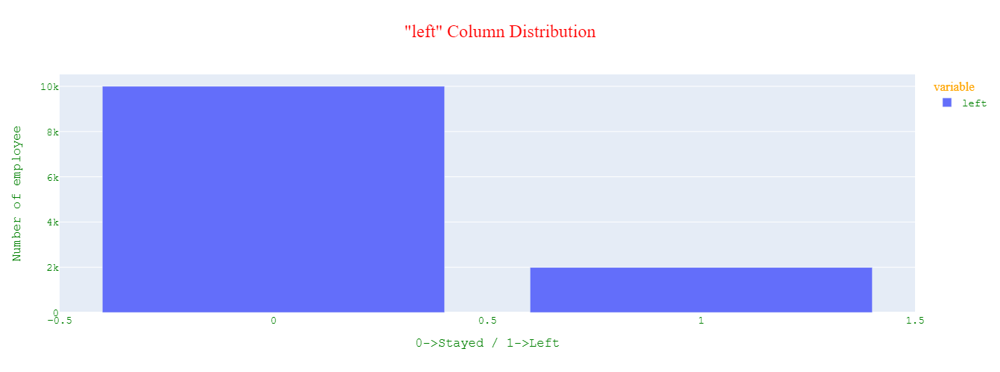

In [27]:
fig = px.bar(df['left'].value_counts(),
             labels={"index": "0->Stayed / 1->Left","value": "Number of employee"},
             title = '"left" Column Distribution')
fig.update_layout(width=900,
                  height=500,
                  title_x=0.5,
                  font_family="Courier New", 
                  font_color="green",
                  font_size=14,
                  title_font_family="Times New Roman", 
                  title_font_color="red",
                  title_font_size=24,
                  legend_title_font_family='calibre',
                  legend_title_font_color="orange")
fig.show()

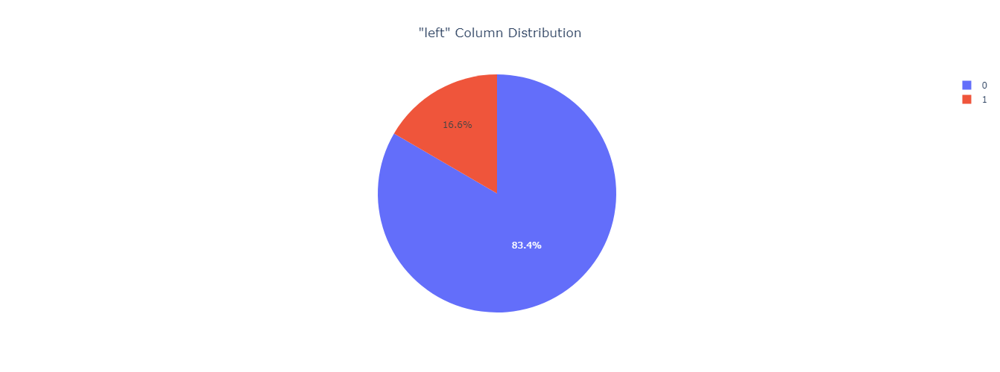

In [28]:
fig = px.pie(df, values = df['left'].value_counts(), 
             names = (df['left'].value_counts()).index, 
             title = '"left" Column Distribution')
fig.update_layout(width=900,
                  height=500,
                  title_x=0.5)
fig.show()

In [29]:
print(f'Percentage of left  : % {round(df.left.value_counts(normalize=True)[1]*100,2)}\
      --> ({df.left.value_counts()[1]} observations for left)\
      \nPercentage of stayed: % {round(df.left.value_counts(normalize=True)[0]*100,2)}\
      --> ({df.left.value_counts()[0]} observations for stayed)')

Percentage of left  : % 16.6      --> (1991 observations for left)      
Percentage of stayed: % 83.4      --> (10000 observations for stayed)


In [33]:
cprint('Dataset describe results according to the "left==1" condition','green')
df[df['left'] == 1].describe().T.style.background_gradient(subset = ['mean','min','50%', 'max'], cmap = 'viridis')

Dataset describe results according to the "left==1" condition


,count,mean,std,min,25%,50%,75%,max
satisfaction_level,1991.000000,0.440271,0.265207,0.090000,0.110000,0.410000,0.730000,0.920000
last_evaluation,1991.000000,0.721783,0.197436,0.450000,0.520000,0.790000,0.910000,1.000000
number_project,1991.000000,3.883476,1.817139,2.000000,2.000000,4.000000,6.000000,7.000000
average_montly_hours,1991.000000,208.162230,61.295145,126.000000,146.000000,226.000000,262.500000,310.000000
time_spend_company,1991.000000,3.881467,0.974041,2.000000,3.000000,4.000000,5.000000,6.000000
work_accident,1991.000000,0.052737,0.223565,0.000000,0.000000,0.000000,0.000000,1.000000
promotion_last_5years,1991.000000,0.004018,0.063277,0.000000,0.000000,0.000000,0.000000,1.000000
left,1991.000000,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [34]:
cprint('Dataset describe results according to the "left==0" condition','green')
df[df['left'] == 0].describe().T.style.background_gradient(subset = ['mean','min','50%', 'max'], cmap = 'viridis')

Dataset describe results according to the "left==0" condition


,count,mean,std,min,25%,50%,75%,max
satisfaction_level,10000.000000,0.667365,0.217082,0.120000,0.540000,0.690000,0.840000,1.000000
last_evaluation,10000.000000,0.715667,0.161919,0.360000,0.580000,0.710000,0.850000,1.000000
number_project,10000.000000,3.786800,0.981755,2.000000,3.000000,4.000000,4.000000,6.000000
average_montly_hours,10000.000000,198.942700,45.665507,96.000000,162.000000,198.000000,238.000000,287.000000
time_spend_company,10000.000000,3.262000,1.367239,2.000000,2.000000,3.000000,4.000000,10.000000
work_accident,10000.000000,0.174500,0.379558,0.000000,0.000000,0.000000,0.000000,1.000000
promotion_last_5years,10000.000000,0.019500,0.138281,0.000000,0.000000,0.000000,0.000000,1.000000
left,10000.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


- 'left' column has binary type values.
- We have an imbalanced data.
- Almost 17% of the employees didn't continue with the company and left.
- 1991 employees left.
- Almost 83% of the employees continue with the company and didn't leave.
- 10000 employees didn't leave.

**Columnn --> "satisfaction_level"**

In [35]:
cprint("Have a First Look to 'satisfaction_level' Column", 'green')
first_look('satisfaction_level')

Have a First Look to 'satisfaction_level' Column


Column name    :satisfaction_level
****************************************************************************************************
Per_of_Nulls   : %0.0
****************************************************************************************************
Num_of_Nulls   : 0
****************************************************************************************************
Num_of_Uniques : 92
****************************************************************************************************
Duplicates     : 0
****************************************************************************************************
Value_counts   : 
Most 10
0.740    214
0.100    203
0.730    201
0.500    200
0.720    199
0.840    199
0.830    196
0.770    194
0.780    194
0.660    192
Name: satisfaction_level, dtype: int64


In [36]:
df.groupby('satisfaction_level').mean().tail(10)

,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,left
satisfaction_level,,,,,,,
0.910,0.746,3.829,202.455,3.481,0.171,0.011,0.128
0.920,0.751,3.822,207.313,3.270,0.160,0.037,0.074
0.930,0.741,3.858,199.561,3.189,0.176,0.020,0.000
0.940,0.727,3.832,203.650,3.049,0.182,0.014,0.000
0.950,0.689,3.725,207.157,3.157,0.183,0.033,0.000
0.960,0.737,3.832,196.816,3.235,0.179,0.006,0.000
0.970,0.722,3.773,200.893,3.173,0.207,0.027,0.000
0.980,0.727,3.758,199.261,3.230,0.176,0.006,0.000
0.990,0.737,3.873,196.439,3.089,0.178,0.006,0.000


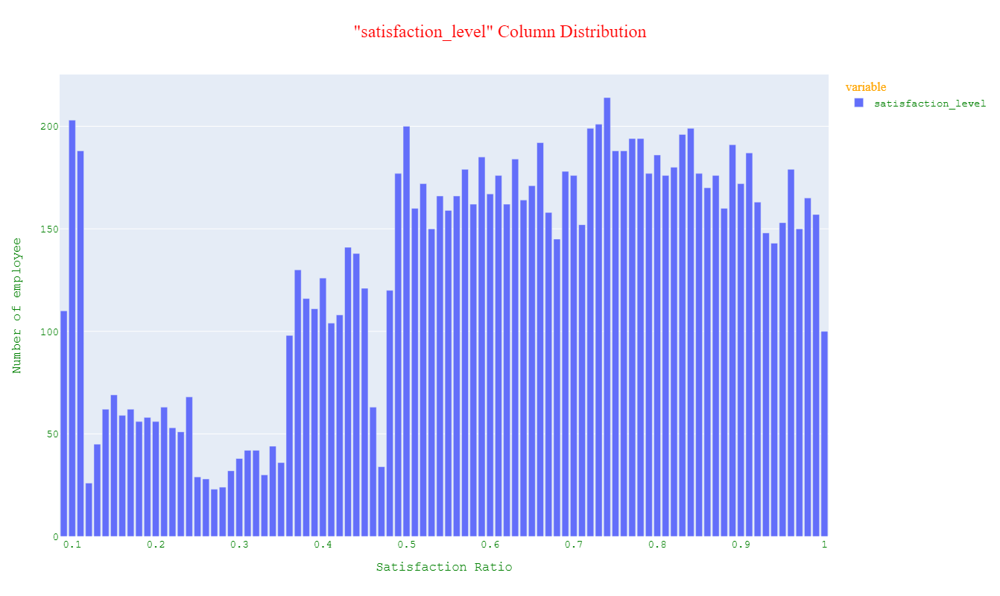

In [37]:
fig = px.bar(df['satisfaction_level'].value_counts(),
             labels={"index": "Satisfaction Ratio", "value":"Number of employee"},
             title = '"satisfaction_level" Column Distribution')
fig.update_layout(width=1400,
                  height=800,
                  title_x=0.5,
                  font_family="Courier New", 
                  font_color="green",
                  font_size=14,
                  title_font_family="Times New Roman", 
                  title_font_color="red",
                  title_font_size=24,
                  legend_title_font_family='calibre',
                  legend_title_font_color="orange")
fig.show()

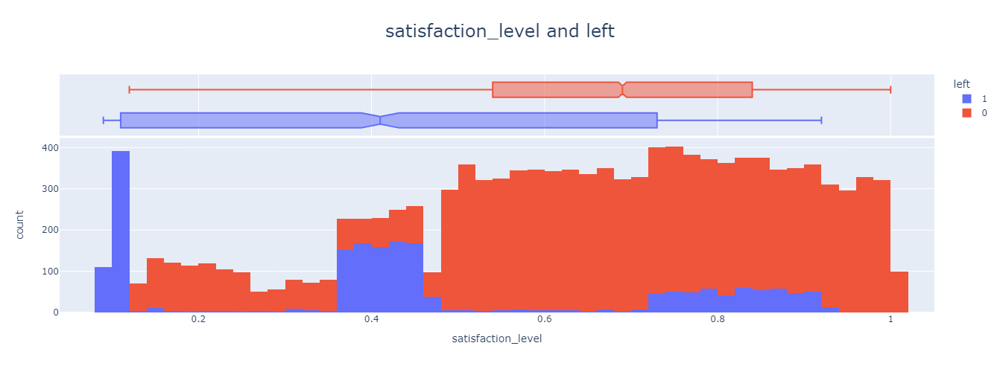

In [38]:
fig = px.histogram(df, x = df['satisfaction_level'], color='left', marginal = "box", hover_data = df.columns, 
             title = 'satisfaction_level and left')
fig.update_layout(width=900,
                  height=500,
                  title_x=0.5,
                  title_font_size=24,)
fig.show()

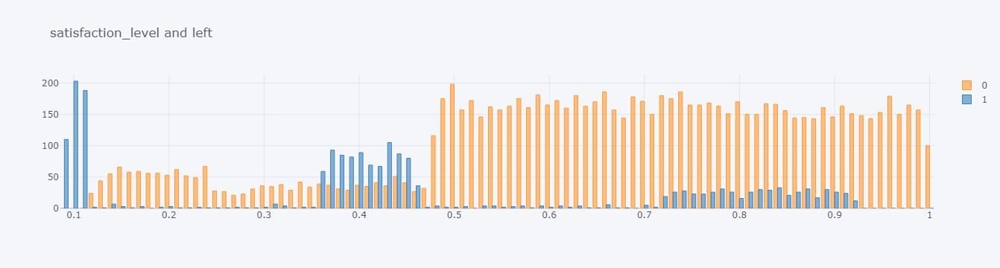

In [39]:
pd.crosstab(df['satisfaction_level'], df['left']).iplot(kind='bar', title = 'satisfaction_level and left')

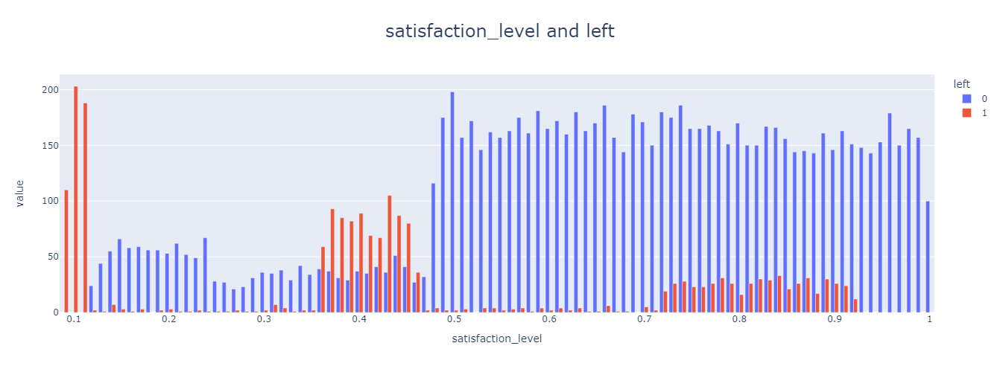

In [40]:
fig = px.bar(data_frame = pd.crosstab(df['satisfaction_level'], df['left']), title = 'satisfaction_level and left', barmode='group')
fig.update_layout(width=1400,
                  height=500,
                  title_x=0.5,
                  title_font_size=24,)
fig.show()

- Although it comes to mind that there should be a linear relationship between 'satisfaction_level' and 'left', it does not look like this on the graph. 
- Those with a 'satisfaction_level' value of around 0.1 are very likely to 'left'. 
- There is a significant increase in the number of those whose 'satisfaction_level' value is between 3.5 and 4.5 and 'left'. In fact, the number of left ones exceeds the notleft ones. 
- When the 'satisfaction_level' value is between 7 and 9, there is an increase in the number of those left. 
- Except for these intervals, no matter how low the satisfaction_level was, those who were stolen continued their work. 

**Columnn --> "last_evaluation"**

In [42]:
cprint("Have a First Look to 'last_evaluation' Column",'green')
first_look('last_evaluation')

Have a First Look to 'last_evaluation' Column


Column name    :last_evaluation
****************************************************************************************************
Per_of_Nulls   : %0.0
****************************************************************************************************
Num_of_Nulls   : 0
****************************************************************************************************
Num_of_Uniques : 65
****************************************************************************************************
Duplicates     : 0
****************************************************************************************************
Value_counts   : 
Most 10
0.550    281
0.500    269
0.510    264
0.570    258
0.540    252
0.560    248
0.530    247
0.850    244
0.900    244
0.490    242
Name: last_evaluation, dtype: int64


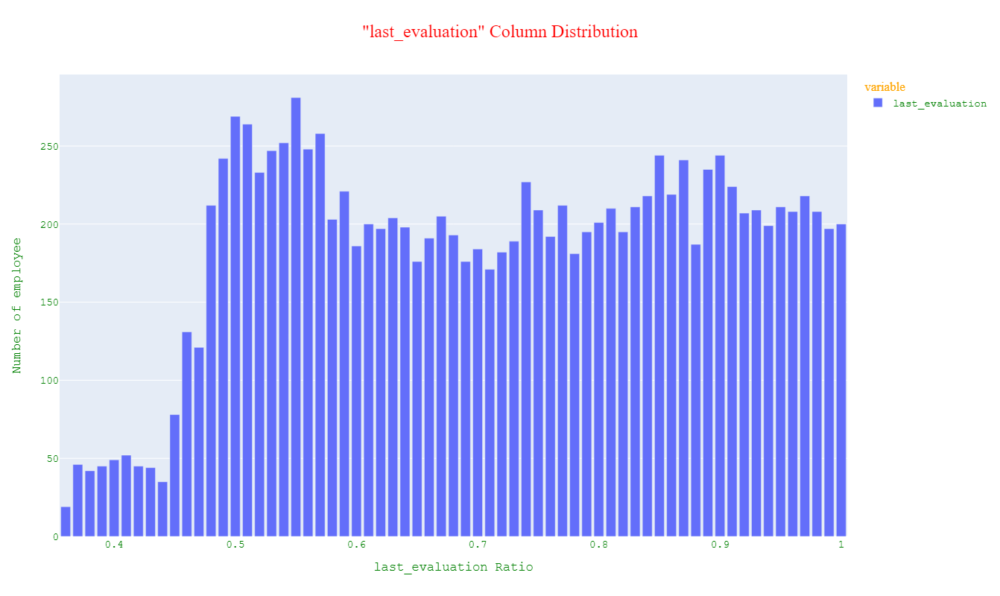

In [43]:
fig = px.bar(df['last_evaluation'].value_counts(),
             labels={"index": "last_evaluation Ratio", "value":"Number of employee"},
             title = '"last_evaluation" Column Distribution')
fig.update_layout(width=1400,
                  height=800,
                  title_x=0.5,
                  font_family="Courier New", 
                  font_color="green",
                  font_size=14,
                  title_font_family="Times New Roman", 
                  title_font_color="red",
                  title_font_size=24,
                  legend_title_font_family='calibre',
                  legend_title_font_color="orange")
fig.show()

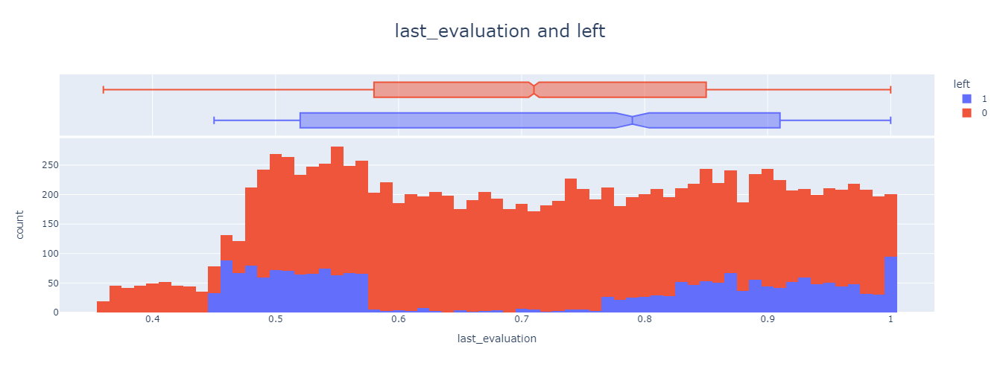

In [44]:
fig = px.histogram(df, x = df['last_evaluation'], color='left', marginal = "box", hover_data = df.columns, 
             title = 'last_evaluation and left')
fig.update_layout(width=900,
                  height=500,
                  title_x=0.5,
                  title_font_size=24,)
fig.show()

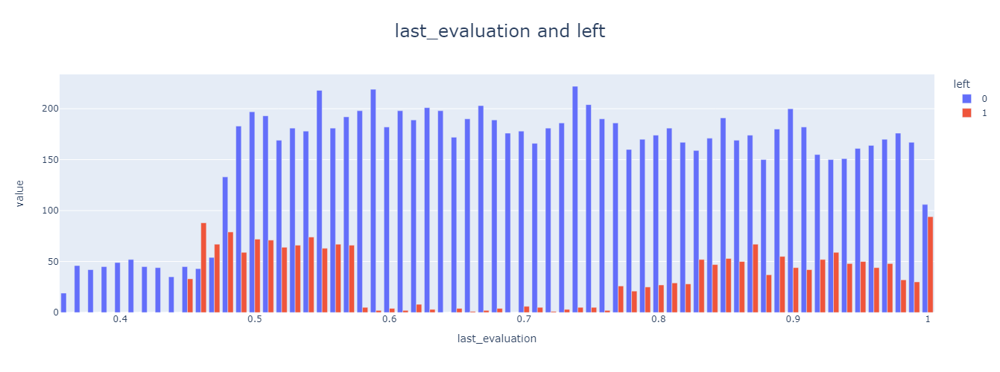

In [45]:
fig = px.bar(data_frame = pd.crosstab(df['last_evaluation'], df['left']), title = 'last_evaluation and left', barmode='group')
fig.update_layout(width=1400,
                  height=500,
                  title_x=0.5,
                  title_font_size=24,)
fig.show()

- There is a local increase between 0.45-0.6 and 0.8-1 in 'last_evaluation' values, as in 'satisfaction_level' values. There is an increase in the number of people who quit their jobs in these intervals. 

**Columnn --> "number_project"**

In [46]:
cprint("Have a First Look to 'number_project' Column",'green')
first_look('number_project')

Have a First Look to 'number_project' Column


Column name    :number_project
****************************************************************************************************
Per_of_Nulls   : %0.0
****************************************************************************************************
Num_of_Nulls   : 0
****************************************************************************************************
Num_of_Uniques : 6
****************************************************************************************************
Duplicates     : 0
****************************************************************************************************
Value_counts   : 
Most 10
4    3685
3    3520
5    2233
2    1582
6     826
7     145
Name: number_project, dtype: int64


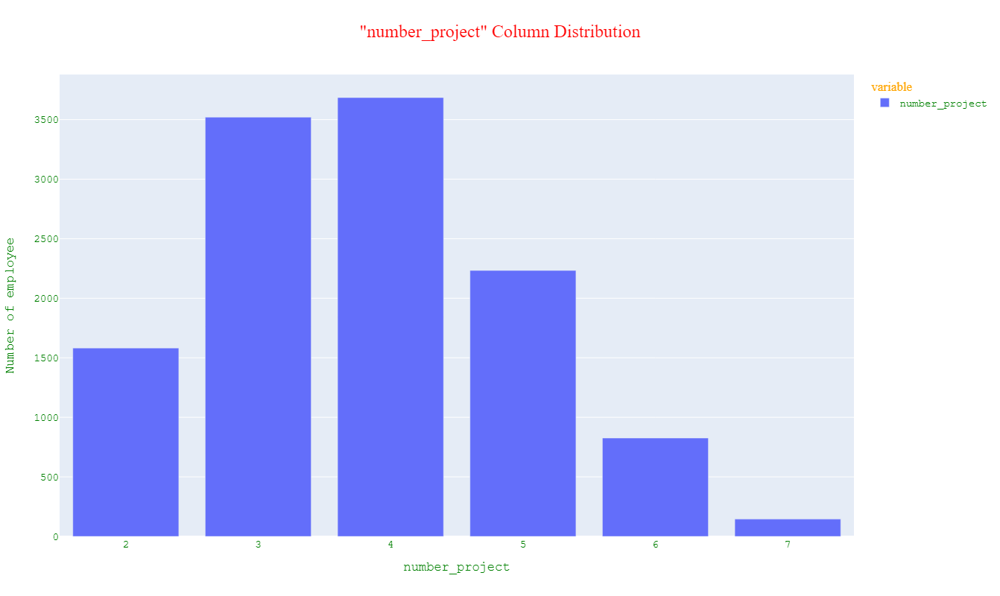

In [47]:
fig = px.bar(df['number_project'].value_counts(),
             labels={"index": "number_project", "value":"Number of employee"},
             title = '"number_project" Column Distribution')
fig.update_layout(width=1400,
                  height=800,
                  title_x=0.5,
                  font_family="Courier New", 
                  font_color="green",
                  font_size=14,
                  title_font_family="Times New Roman", 
                  title_font_color="red",
                  title_font_size=24,
                  legend_title_font_family='calibre',
                  legend_title_font_color="orange")
fig.show()

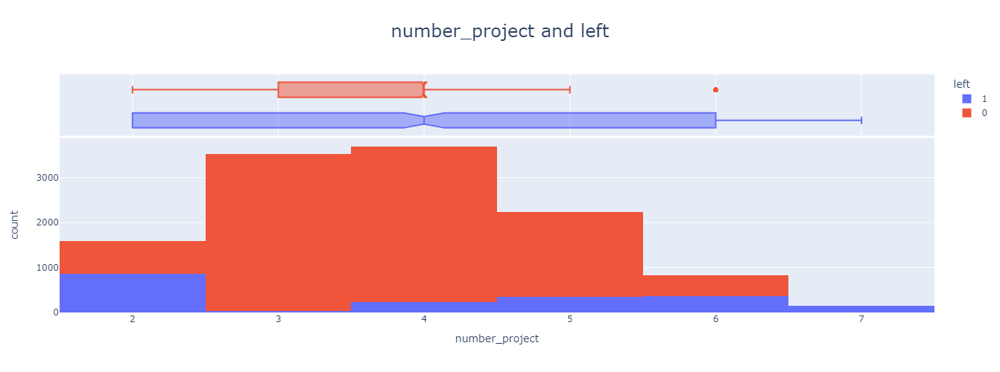

In [48]:
fig = px.histogram(df, x = df['number_project'], color='left', marginal = "box", hover_data = df.columns, 
             title = 'number_project and left')
fig.update_layout(width=900,
                  height=500,
                  title_x=0.5,
                  title_font_size=24,)
fig.show()

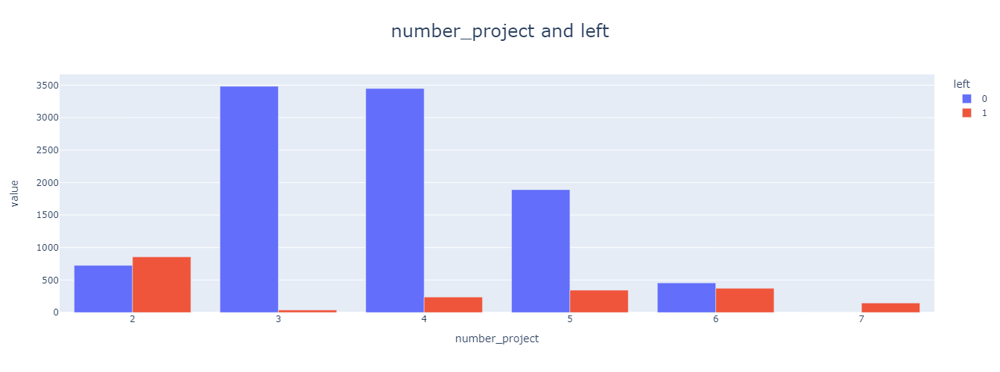

In [49]:
fig = px.bar(data_frame = pd.crosstab(df['number_project'], df['left']), title = 'number_project and left', barmode='group')
fig.update_layout(width=1400,
                  height=500,
                  title_x=0.5,
                  title_font_size=24,)
fig.show()

**Columnn --> "average_montly_hours"**

In [50]:
cprint("Have a First Look to 'average_montly_hours' Column",'green')
first_look('average_montly_hours')

Have a First Look to 'average_montly_hours' Column


Column name    :average_montly_hours
****************************************************************************************************
Per_of_Nulls   : %0.0
****************************************************************************************************
Num_of_Nulls   : 0
****************************************************************************************************
Num_of_Uniques : 215
****************************************************************************************************
Duplicates     : 0
****************************************************************************************************
Value_counts   : 
Most 10
156    112
149    112
160    111
151    107
135    104
260    102
257    100
145     98
157     96
224     94
Name: average_montly_hours, dtype: int64


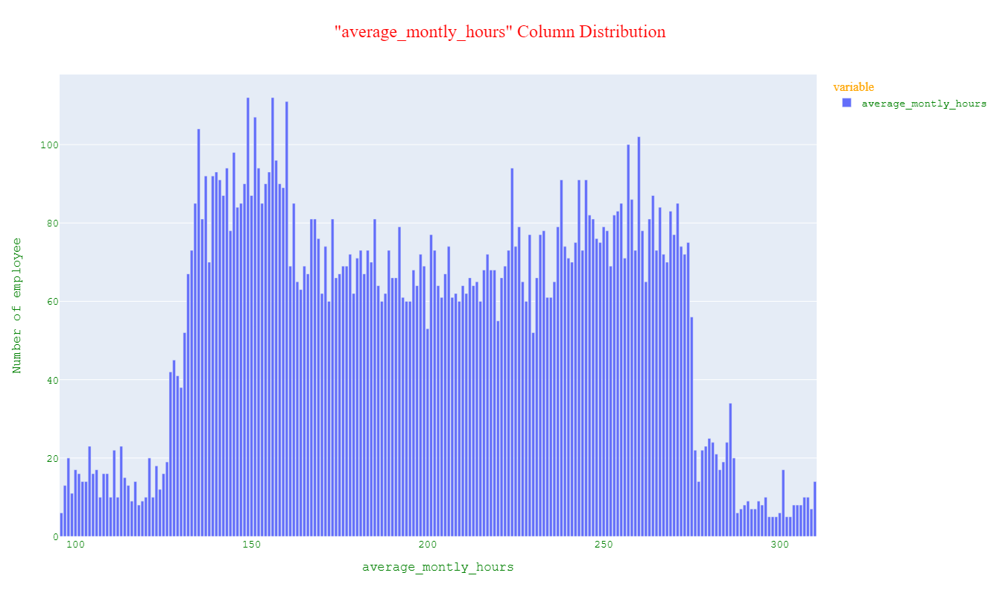

In [51]:
fig = px.bar(df['average_montly_hours'].value_counts(),
             labels={"index": "average_montly_hours", "value":"Number of employee"},
             title = '"average_montly_hours" Column Distribution')
fig.update_layout(width=1400,
                  height=800,
                  title_x=0.5,
                  font_family="Courier New", 
                  font_color="green",
                  font_size=14,
                  title_font_family="Times New Roman", 
                  title_font_color="red",
                  title_font_size=24,
                  legend_title_font_family='calibre',
                  legend_title_font_color="orange")
fig.show()

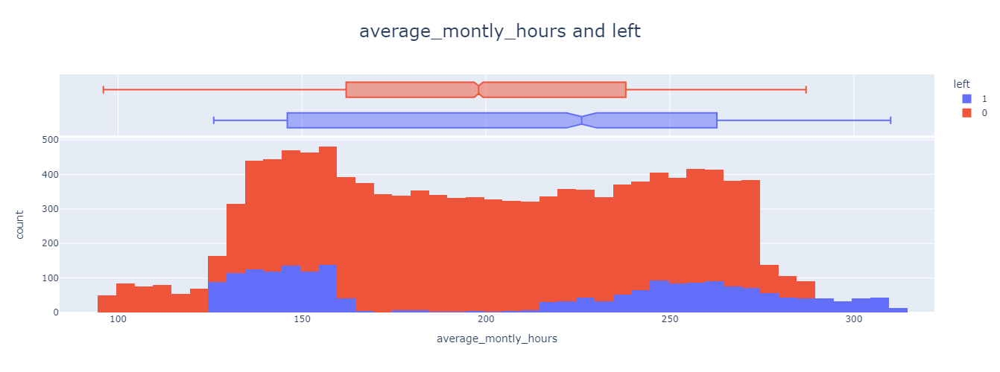

In [52]:
fig = px.histogram(df, x = df['average_montly_hours'], color='left', marginal = "box", hover_data = df.columns, 
             title = 'average_montly_hours and left')
fig.update_layout(width=900,
                  height=500,
                  title_x=0.5,
                  title_font_size=24,)
fig.show()

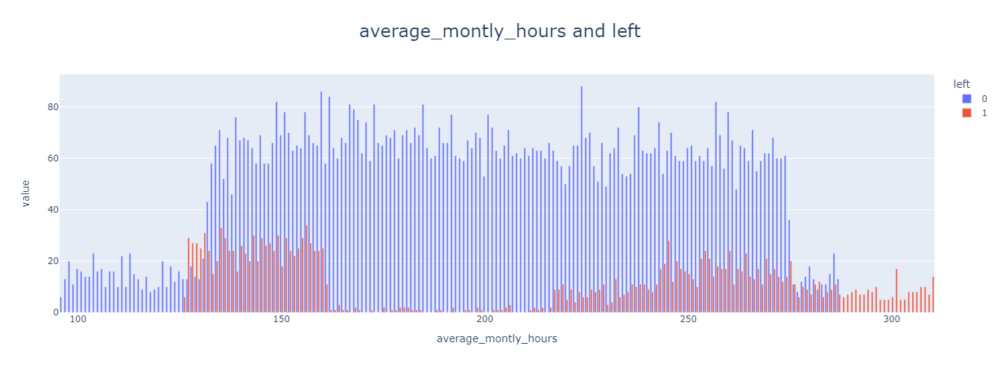

In [53]:
fig = px.bar(data_frame = pd.crosstab(df['average_montly_hours'], df['left']), title = 'average_montly_hours and left', barmode='group')
fig.update_layout(width=1400,
                  height=500,
                  title_x=0.5,
                  title_font_size=24,)
fig.show()

- Looking at the 'average_montly_hours' values, there is a local increase in turnover in the 125-160 month working hours range and 210-290 monthly working hours. 
- Those who work more than 290 hours per month are more likely to quit their jobs than those who do not. 

**Columnn --> "time_spend_company"**

In [54]:
cprint("Have a First Look to 'time_spend_company' Column",'green')
first_look('time_spend_company')

Have a First Look to 'time_spend_company' Column


Column name    :time_spend_company
****************************************************************************************************
Per_of_Nulls   : %0.0
****************************************************************************************************
Num_of_Nulls   : 0
****************************************************************************************************
Num_of_Uniques : 8
****************************************************************************************************
Duplicates     : 0
****************************************************************************************************
Value_counts   : 
Most 10
3     5190
2     2910
4     2005
5     1062
6      542
10     107
7       94
8       81
Name: time_spend_company, dtype: int64


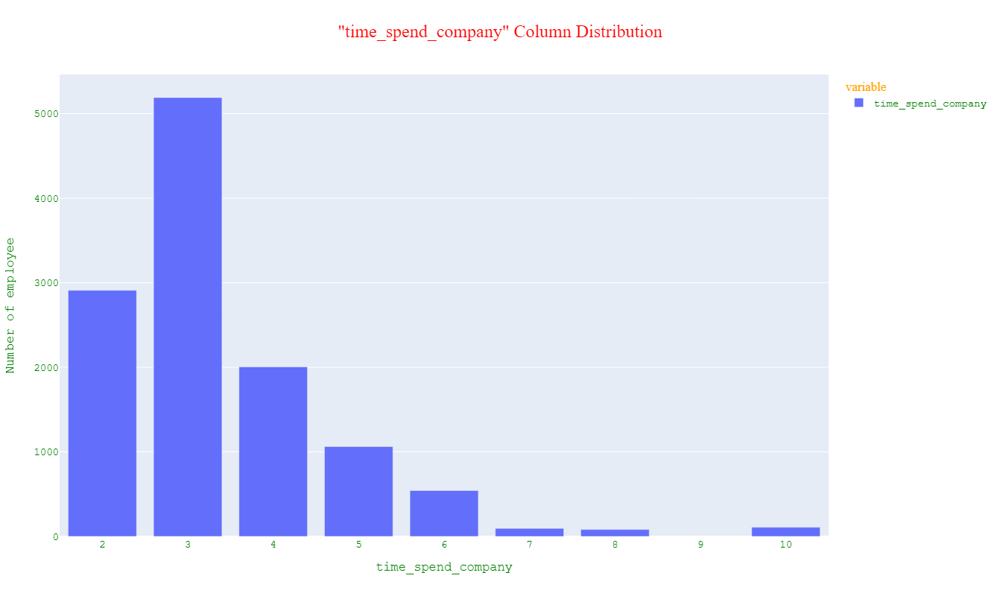

In [55]:
fig = px.bar(df['time_spend_company'].value_counts(),
             labels={"index": "time_spend_company", "value":"Number of employee"},
             title = '"time_spend_company" Column Distribution')
fig.update_layout(width=1400,
                  height=800,
                  title_x=0.5,
                  font_family="Courier New", 
                  font_color="green",
                  font_size=14,
                  title_font_family="Times New Roman", 
                  title_font_color="red",
                  title_font_size=24,
                  legend_title_font_family='calibre',
                  legend_title_font_color="orange")
fig.show()

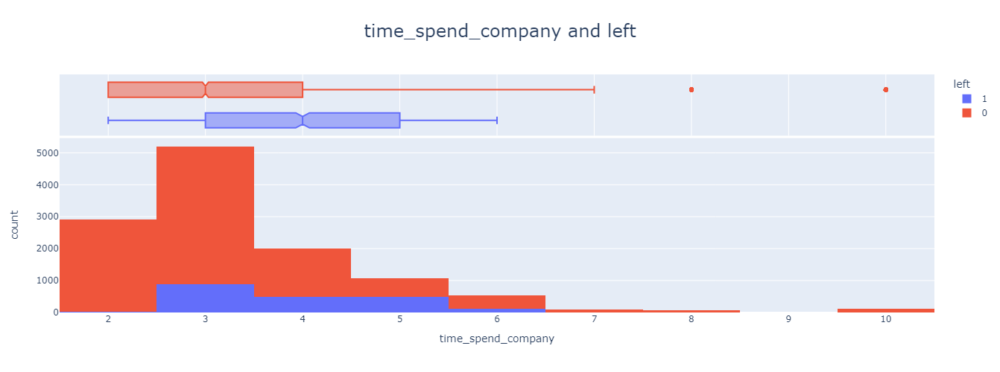

In [56]:
fig = px.histogram(df, x = df['time_spend_company'], color='left', marginal = "box", hover_data = df.columns, 
             title = 'time_spend_company and left')
fig.update_layout(width=900,
                  height=500,
                  title_x=0.5,
                  title_font_size=24,)
fig.show()

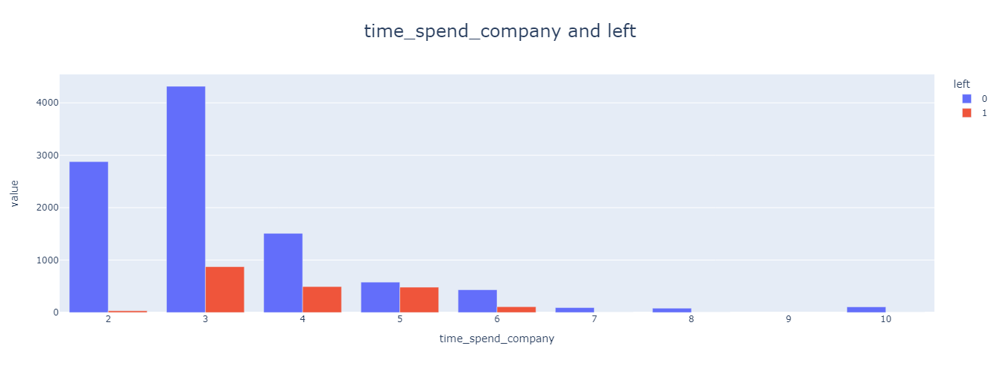

In [57]:
fig = px.bar(data_frame = pd.crosstab(df['time_spend_company'], df['left']), title = 'time_spend_company and left', barmode='group')
fig.update_layout(width=1400,
                  height=500,
                  title_x=0.5,
                  title_font_size=24,)
fig.show()

- Looking at the 'time_spent_company' values, there is an increase in turnover in the 3rd working year, but this increase gradually decreases until the 6th working year. 

**Columnn --> "work_accident"**

In [58]:
cprint("Have a First Look to 'work_accident' Column",'green')
first_look('work_accident')

Have a First Look to 'work_accident' Column


Column name    :work_accident
****************************************************************************************************
Per_of_Nulls   : %0.0
****************************************************************************************************
Num_of_Nulls   : 0
****************************************************************************************************
Num_of_Uniques : 2
****************************************************************************************************
Duplicates     : 0
****************************************************************************************************
Value_counts   : 
Most 10
0    10141
1     1850
Name: work_accident, dtype: int64


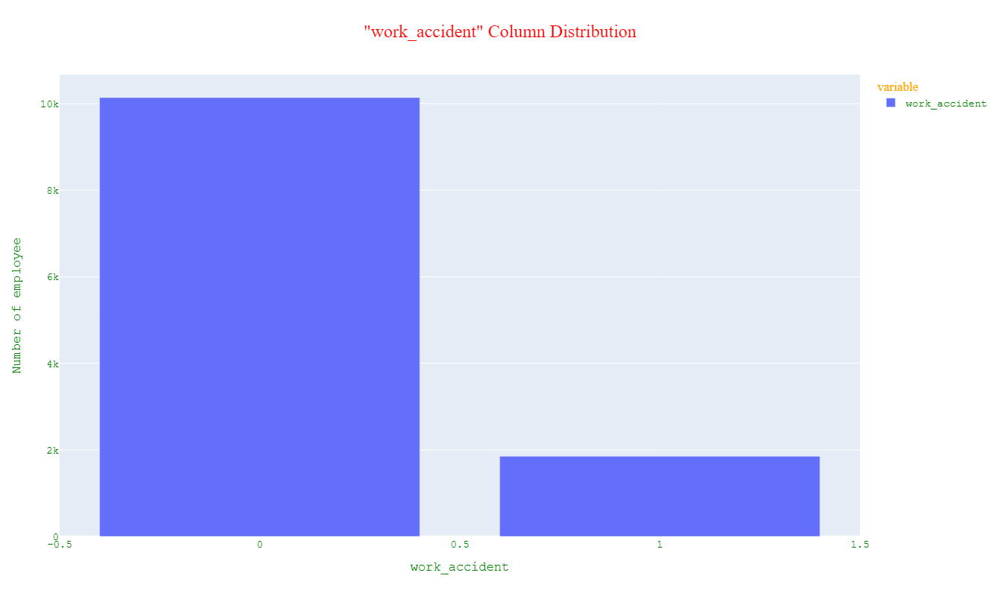

In [59]:
fig = px.bar(df['work_accident'].value_counts(),
             labels={"index": "work_accident", "value":"Number of employee"},
             title = '"work_accident" Column Distribution')
fig.update_layout(width=1400,
                  height=800,
                  title_x=0.5,
                  font_family="Courier New", 
                  font_color="green",
                  font_size=14,
                  title_font_family="Times New Roman", 
                  title_font_color="red",
                  title_font_size=24,
                  legend_title_font_family='calibre',
                  legend_title_font_color="orange")
fig.show()

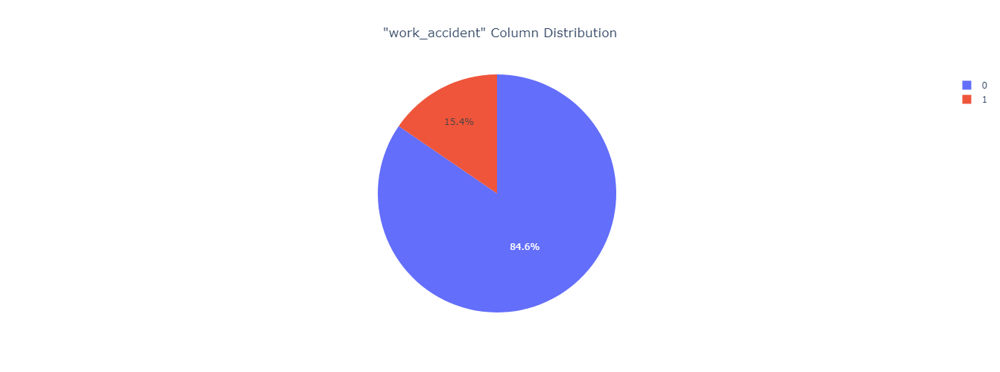

In [60]:
fig = px.pie(df, values = df['work_accident'].value_counts(), 
             names = (df['work_accident'].value_counts()).index, 
             title = '"work_accident" Column Distribution')
fig.update_layout(width=900,
                  height=500,
                  title_x=0.5)
fig.show()

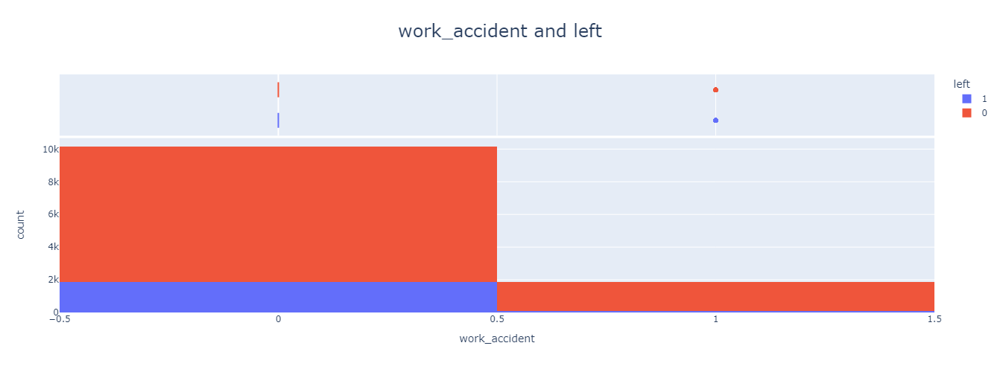

In [61]:
fig = px.histogram(df, x = df['work_accident'], color='left', marginal = "box", hover_data = df.columns, 
             title = 'work_accident and left')
fig.update_layout(width=900,
                  height=500,
                  title_x=0.5,
                  title_font_size=24,)
fig.show()

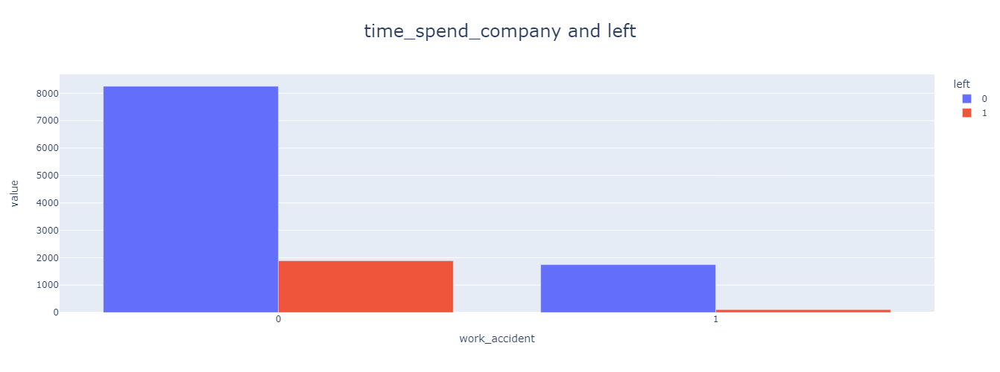

In [62]:
fig = px.bar(data_frame = pd.crosstab(df['work_accident'], df['left']), title = 'time_spend_company and left', barmode='group')
fig.update_layout(width=1400,
                  height=500,
                  title_x=0.5,
                  title_font_size=24,)
fig.show()

- 'work_accident' column has binary type values.
- Left ratios are similar between those who have had a work accident and those who have not. 
- It does not appear to be a determining factor. In fact, it can be said that the left rate of those who have had a work accident is proportionally lower. 

**Columnn --> "promotion_last_5years"**

In [63]:
cprint("Have a First Look to 'promotion_last_5years' Column",'green')
first_look('promotion_last_5years')

Have a First Look to 'promotion_last_5years' Column


Column name    :promotion_last_5years
****************************************************************************************************
Per_of_Nulls   : %0.0
****************************************************************************************************
Num_of_Nulls   : 0
****************************************************************************************************
Num_of_Uniques : 2
****************************************************************************************************
Duplicates     : 0
****************************************************************************************************
Value_counts   : 
Most 10
0    11788
1      203
Name: promotion_last_5years, dtype: int64


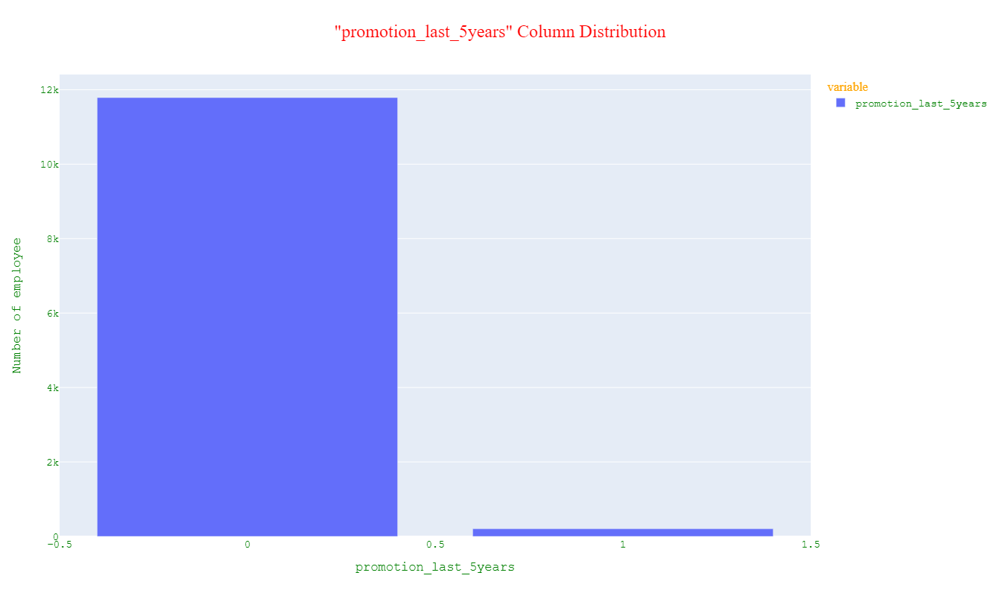

In [64]:
fig = px.bar(df['promotion_last_5years'].value_counts(),
             labels={"index": "promotion_last_5years", "value":"Number of employee"},
             title = '"promotion_last_5years" Column Distribution')
fig.update_layout(width=1400,
                  height=800,
                  title_x=0.5,
                  font_family="Courier New", 
                  font_color="green",
                  font_size=14,
                  title_font_family="Times New Roman", 
                  title_font_color="red",
                  title_font_size=24,
                  legend_title_font_family='calibre',
                  legend_title_font_color="orange")
fig.show()

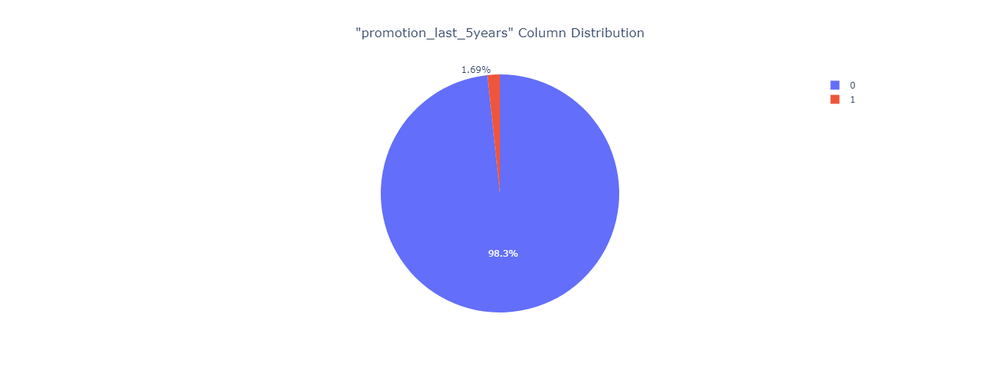

In [65]:
fig = px.pie(df, values = df['promotion_last_5years'].value_counts(), 
             names = (df['promotion_last_5years'].value_counts()).index, 
             title = '"promotion_last_5years" Column Distribution')
fig.update_layout(width=900,
                  height=500,
                  title_x=0.5)
fig.show()

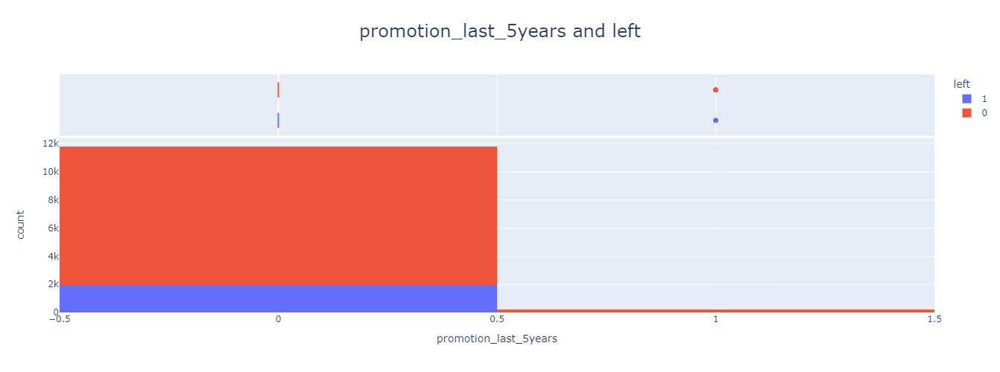

In [66]:
fig = px.histogram(df, x = df['promotion_last_5years'], color='left', marginal = "box", hover_data = df.columns, 
             title = 'promotion_last_5years and left')
fig.update_layout(width=900,
                  height=500,
                  title_x=0.5,
                  title_font_size=24,)
fig.show()

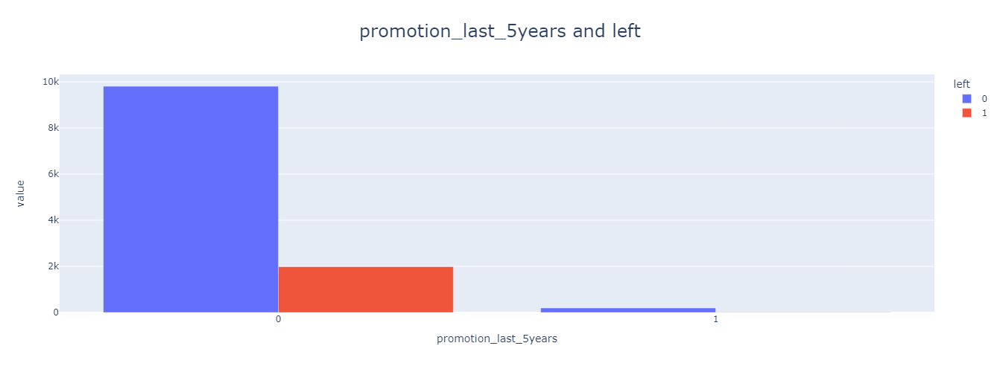

In [67]:
fig = px.bar(data_frame = pd.crosstab(df['promotion_last_5years'], df['left']), title = 'promotion_last_5years and left', barmode='group')
fig.update_layout(width=1400,
                  height=500,
                  title_x=0.5,
                  title_font_size=24,)
fig.show()

- 'promotion_last_5years' column has binary type values.
- Receiving a promotion in the last 5 working years is not determinative in terms of leaving or continuing to work. 
- However, the percentage of those who receive promotions, even if it is small, are higher than those who do not.

**Columnn --> "departments"**

In [68]:
cprint("Have a First Look to 'departments' Column",'green')
first_look('departments')

Have a First Look to 'departments' Column


Column name    :departments
****************************************************************************************************
Per_of_Nulls   : %0.0
****************************************************************************************************
Num_of_Nulls   : 0
****************************************************************************************************
Num_of_Uniques : 10
****************************************************************************************************
Duplicates     : 0
****************************************************************************************************
Value_counts   : 
Most 10
sales          3239
technical      2244
support        1821
IT              976
RandD           694
product_mng     686
marketing       673
accounting      621
hr              601
management      436
Name: departments, dtype: int64


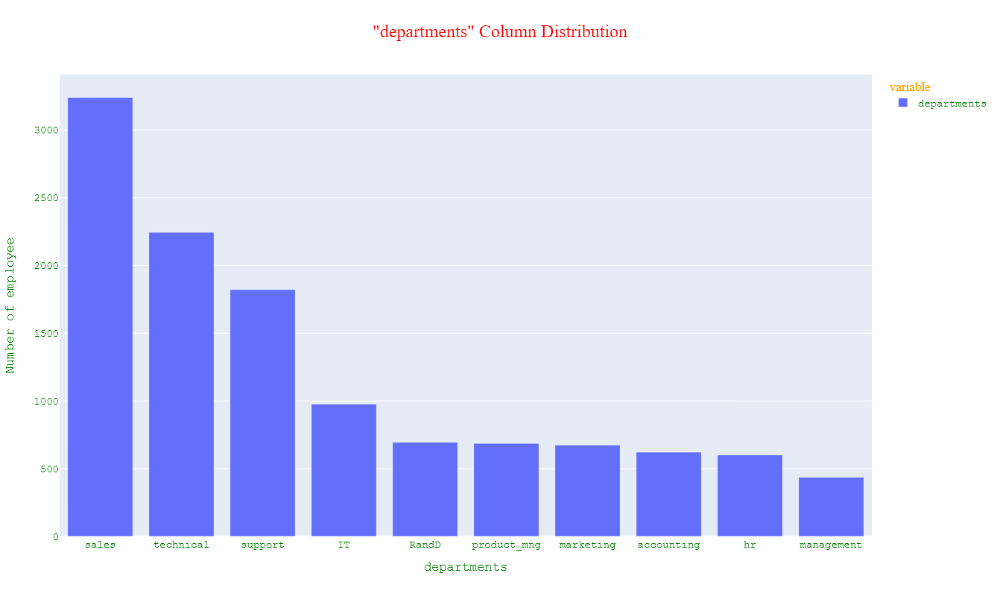

In [69]:
fig = px.bar(df['departments'].value_counts(),
             labels={"index": "departments", "value":"Number of employee"},
             title = '"departments" Column Distribution')
fig.update_layout(width=1400,
                  height=800,
                  title_x=0.5,
                  font_family="Courier New", 
                  font_color="green",
                  font_size=14,
                  title_font_family="Times New Roman", 
                  title_font_color="red",
                  title_font_size=24,
                  legend_title_font_family='calibre',
                  legend_title_font_color="orange")
fig.show()

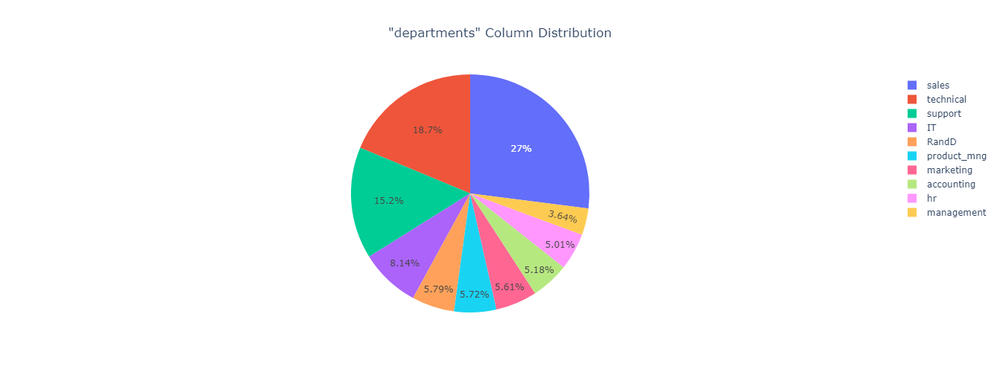

In [70]:
fig = px.pie(df, values = df['departments'].value_counts(), 
             names = (df['departments'].value_counts()).index, 
             title = '"departments" Column Distribution')
fig.update_layout(width=900,
                  height=500,
                  title_x=0.5)
fig.show()

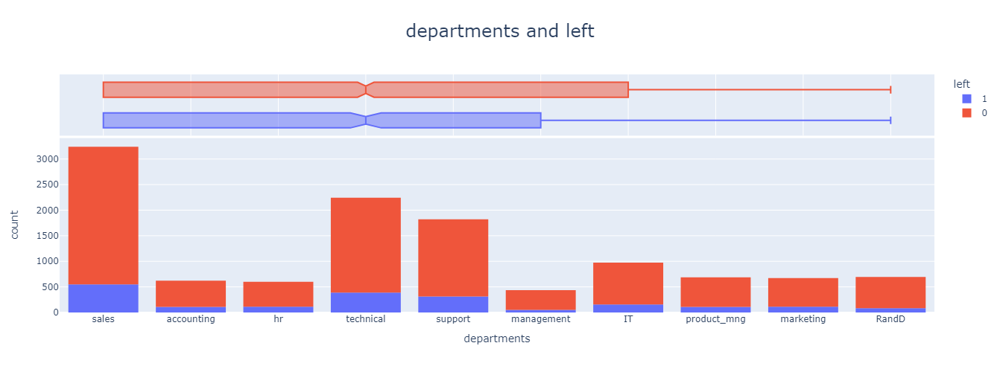

In [73]:
fig = px.histogram(df, x = df['departments'], color='left', marginal = "box", hover_data = df.columns, 
             title = 'departments and left')
fig.update_layout(width=900,
                  height=500,
                  title_x=0.5,
                  title_font_size=24,)
fig.show()

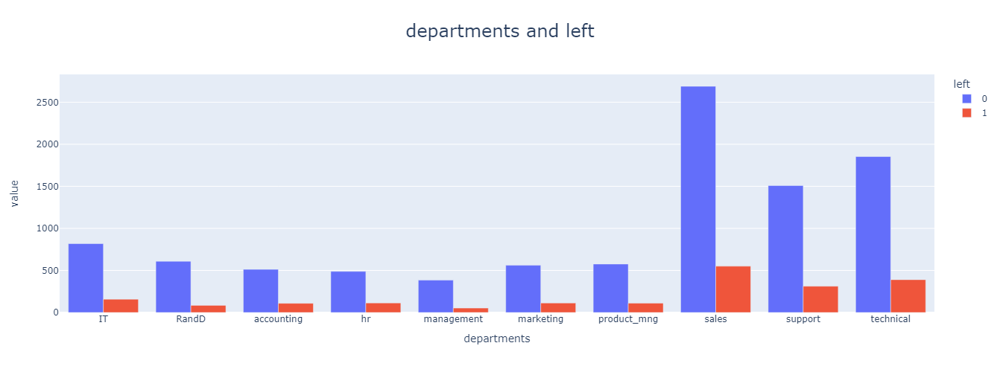

In [74]:
fig = px.bar(data_frame = pd.crosstab(df['departments'], df['left']), title = 'departments and left', barmode='group')
fig.update_layout(width=1400,
                  height=500,
                  title_x=0.5,
                  title_font_size=24,)
fig.show()

- It is not observed that the departments worked alone have an effect on the left decision. 
- It is seen that the left percentages of the departments are similar. 

**Columnn --> "salary"**

In [75]:
cprint("Have a First Look to 'salary' Column",'green')
first_look('salary')

Have a First Look to 'salary' Column


Column name    :salary
****************************************************************************************************
Per_of_Nulls   : %0.0
****************************************************************************************************
Num_of_Nulls   : 0
****************************************************************************************************
Num_of_Uniques : 3
****************************************************************************************************
Duplicates     : 0
****************************************************************************************************
Value_counts   : 
Most 10
low       5740
medium    5261
high       990
Name: salary, dtype: int64


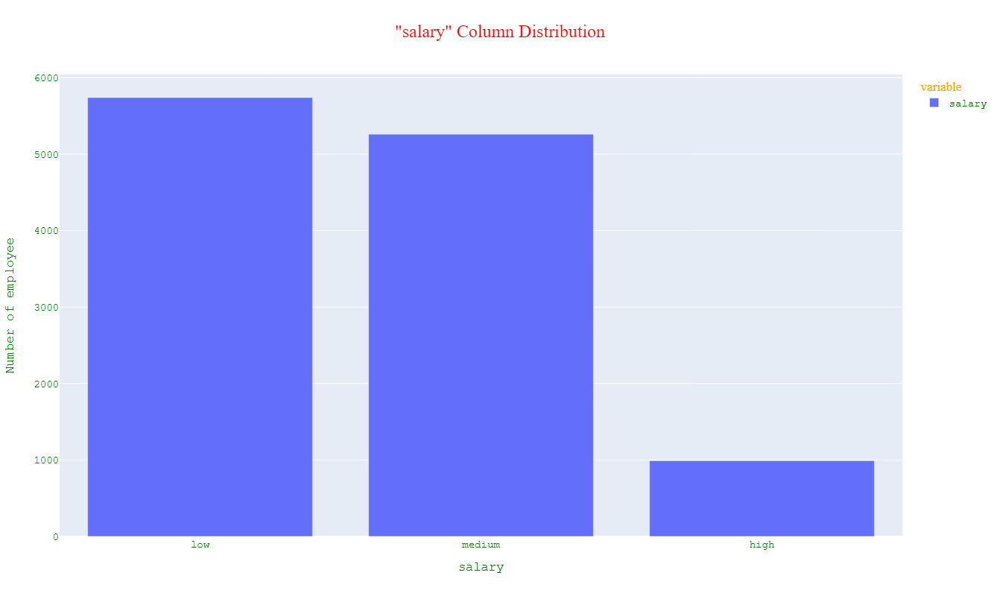

In [76]:
fig = px.bar(df['salary'].value_counts(),
             labels={"index": "salary", "value":"Number of employee"},
             title = '"salary" Column Distribution')
fig.update_layout(width=1400,
                  height=800,
                  title_x=0.5,
                  font_family="Courier New", 
                  font_color="green",
                  font_size=14,
                  title_font_family="Times New Roman", 
                  title_font_color="red",
                  title_font_size=24,
                  legend_title_font_family='calibre',
                  legend_title_font_color="orange")
fig.show()

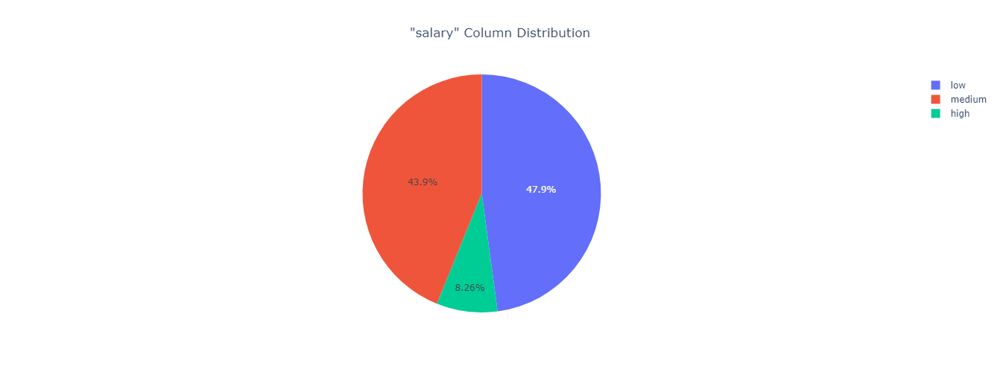

In [77]:
fig = px.pie(df, values = df['salary'].value_counts(), 
             names = (df['salary'].value_counts()).index, 
             title = '"salary" Column Distribution')
fig.update_layout(width=900,
                  height=500,
                  title_x=0.5)
fig.show()

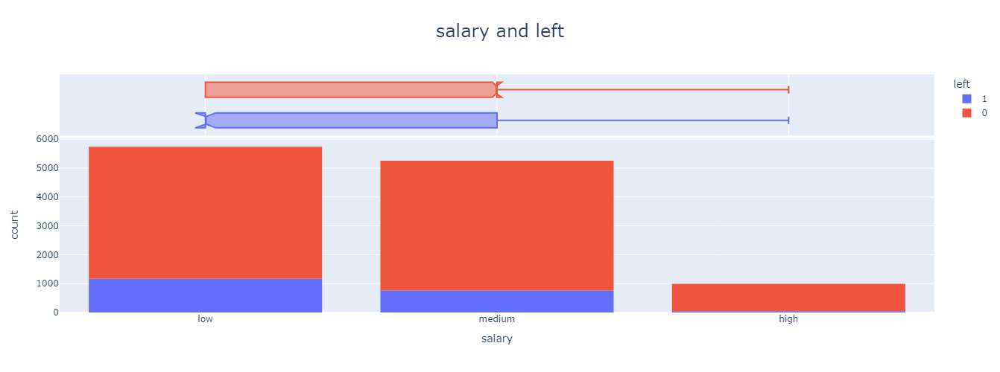

In [78]:
fig = px.histogram(df, x = df['salary'], color='left', marginal = "box", hover_data = df.columns, 
             title = 'salary and left')
fig.update_layout(width=900,
                  height=500,
                  title_x=0.5,
                  title_font_size=24,)
fig.show()

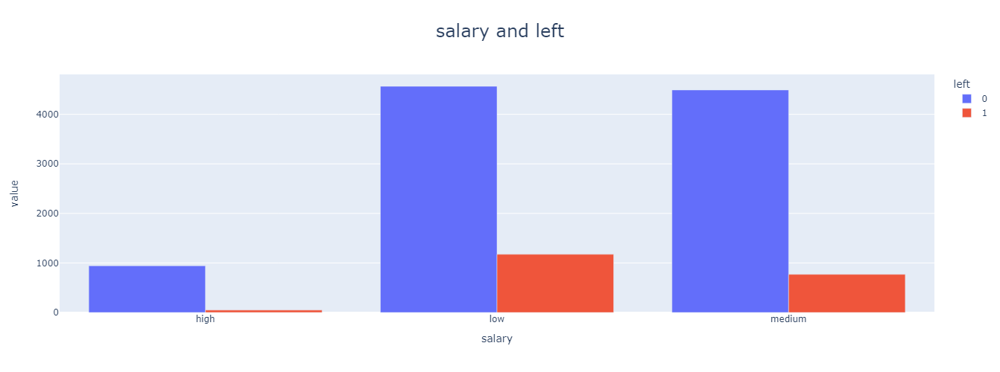

In [79]:
fig = px.bar(data_frame = pd.crosstab(df['salary'], df['left']), title = 'salary and left', barmode='group')
fig.update_layout(width=1400,
                  height=500,
                  title_x=0.5,
                  title_font_size=24,)
fig.show()

- It is seen that the left percentages of the salary are similar. 
- Even if it is small, there is an increase in the form of high-medium-low according to the salary status. 

***Let's go on with the examination of numerical and categorical columns.***

In [80]:
numerical= df.drop(['left'], axis = 1).select_dtypes('number').columns

categorical = df.select_dtypes('object').columns

print('---------------------')
print(f'Numerical Columns:  {df[numerical].columns}')
print(f'Categorical Columns: {df[categorical].columns}')
print('---------------------')

---------------------
Numerical Columns:  Index(['satisfaction_level', 'last_evaluation', 'number_project',
       'average_montly_hours', 'time_spend_company', 'work_accident',
       'promotion_last_5years'],
      dtype='object')
Categorical Columns: Index(['departments', 'salary'], dtype='object')
---------------------


In [81]:
df.head()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,departments,salary,left
0,0.380,0.530,2,157,3,0,0,sales,low,1
1,0.800,0.860,5,262,6,0,0,sales,medium,1
2,0.110,0.880,7,272,4,0,0,sales,medium,1
3,0.720,0.870,5,223,5,0,0,sales,low,1
4,0.370,0.520,2,159,3,0,0,sales,low,1


In [82]:
df[numerical].describe().T.style.background_gradient(subset = ['mean','std','50%','count'], cmap = 'viridis')

,count,mean,std,min,25%,50%,75%,max
satisfaction_level,11991.000000,0.629658,0.241070,0.090000,0.480000,0.660000,0.820000,1.000000
last_evaluation,11991.000000,0.716683,0.168343,0.360000,0.570000,0.720000,0.860000,1.000000
number_project,11991.000000,3.802852,1.163238,2.000000,3.000000,4.000000,5.000000,7.000000
average_montly_hours,11991.000000,200.473522,48.727813,96.000000,157.000000,200.000000,243.000000,310.000000
time_spend_company,11991.000000,3.364857,1.330240,2.000000,3.000000,3.000000,4.000000,10.000000
work_accident,11991.000000,0.154282,0.361234,0.000000,0.000000,0.000000,0.000000,1.000000
promotion_last_5years,11991.000000,0.016929,0.129012,0.000000,0.000000,0.000000,0.000000,1.000000


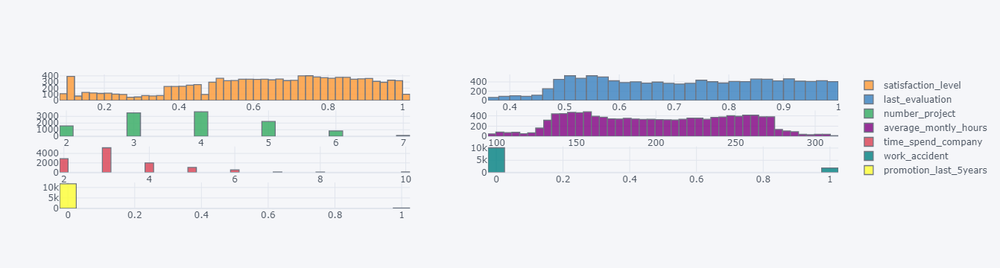

In [83]:
df[numerical].iplot(kind = 'histogram', subplots = True, bins = 50)

In [87]:
# THIS CODE AND PRESENTATION GAVE A HARD TIME TO THE COMPUTER EVEN AFTER IT WAS COMPLETED, So I WILL NOT EXECUTE IT
# for i in numerical:
#     df[i].iplot(kind = 'box', title = i, boxpoints = 'all')

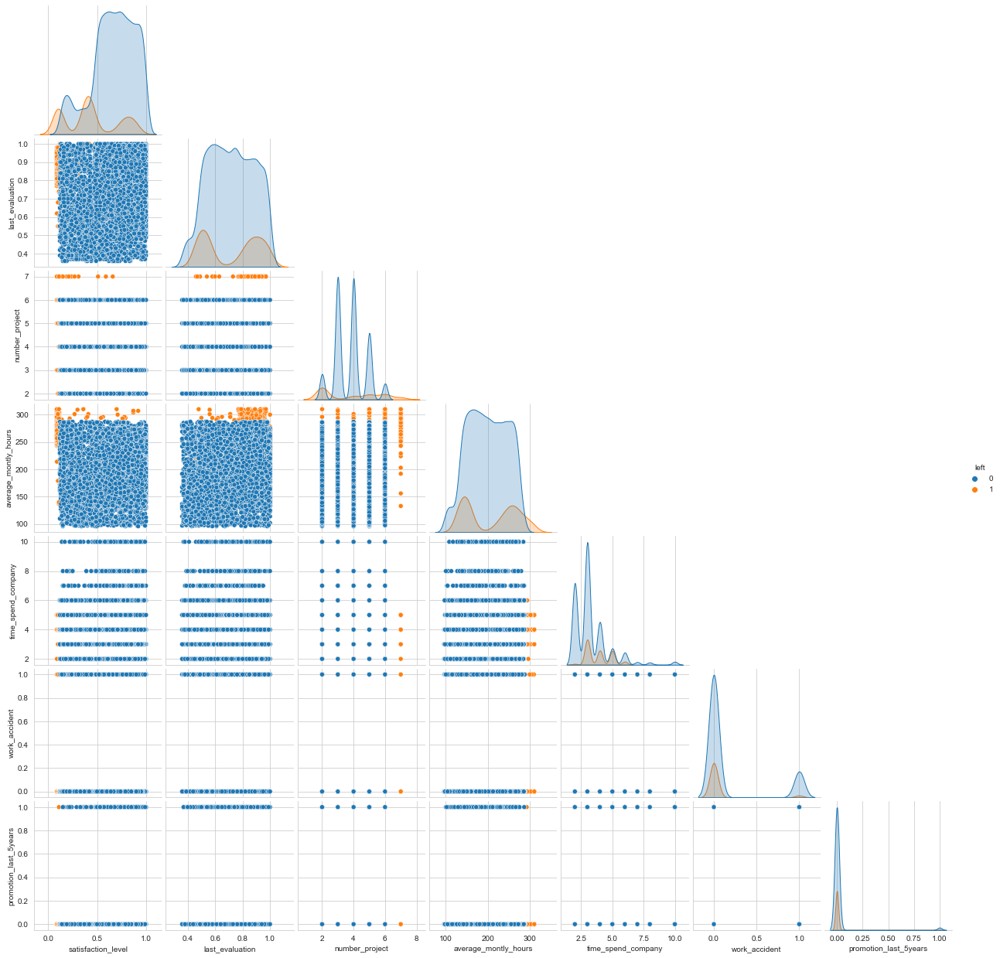

In [88]:
sns.set_style("whitegrid")
sns.pairplot(df, hue = "left", corner = True);

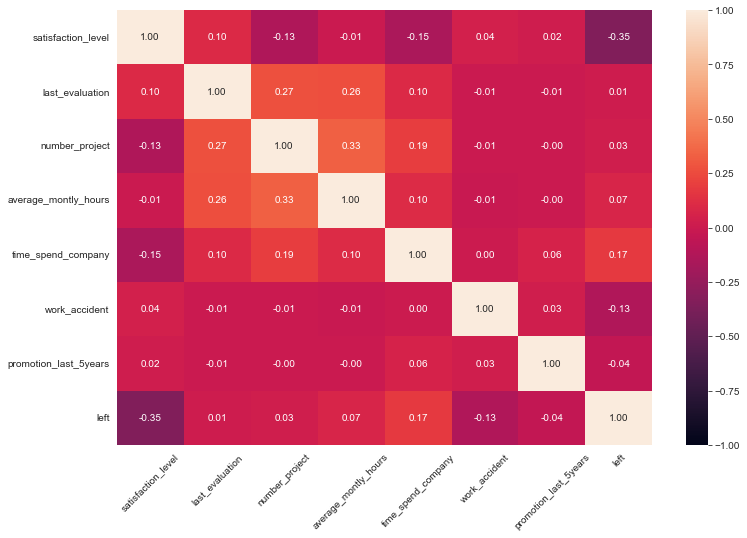

In [89]:
plt.figure(figsize = (12, 8))
sns.heatmap (df.corr(), annot = True, fmt = '.2f', vmin = -1, vmax = 1)
plt.xticks(rotation = 45);

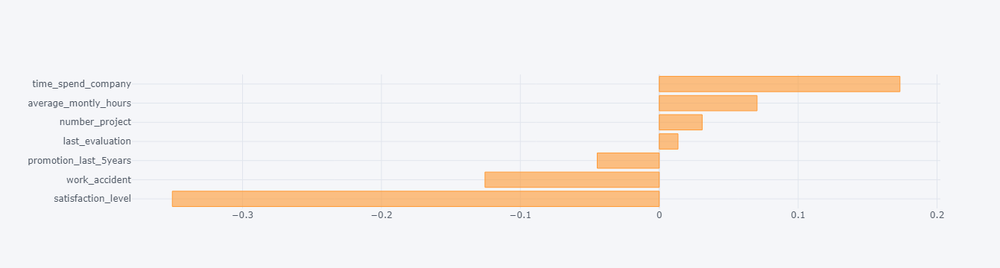

In [92]:
df.corr()['left'].sort_values().drop('left').iplot(kind = 'barh');

In [93]:
df_temp = df.corr()

count = 'Done'
feature =[]
collinear= []
for col in df_temp.columns:
    for i in df_temp.index:
        if (df_temp[col][i] > .9 and df_temp[col][i] < 1) or (df_temp[col][i] < -.9 and df_temp[col][i] > -1) :
                feature.append(col)
                collinear.append(i)
                print(Fore.RED + f'\033[1mmulticolinearity alert in between\033[0m {col} - {i}')
        else:
            print(f'For {col} and {i}, there is NO multicollinearity problem') 

print('\033[1mThe number of strong corelated features:\033[0m', count) 

For satisfaction_level and satisfaction_level, there is NO multicollinearity problem
For satisfaction_level and last_evaluation, there is NO multicollinearity problem
For satisfaction_level and number_project, there is NO multicollinearity problem
For satisfaction_level and average_montly_hours, there is NO multicollinearity problem
For satisfaction_level and time_spend_company, there is NO multicollinearity problem
For satisfaction_level and work_accident, there is NO multicollinearity problem
For satisfaction_level and promotion_last_5years, there is NO multicollinearity problem
For satisfaction_level and left, there is NO multicollinearity problem
For last_evaluation and satisfaction_level, there is NO multicollinearity problem
For last_evaluation and last_evaluation, there is NO multicollinearity problem
For last_evaluation and number_project, there is NO multicollinearity problem
For last_evaluation and average_montly_hours, there is NO multicollinearity problem
For last_evaluatio

***Based on the examinations made above,***

- There is no multicollinearity problem among the features.
- We have strong level correlation between satisfaction and time_spend_company features and the target column.

In [95]:
df.head()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,departments,salary,left
0,0.380,0.530,2,157,3,0,0,sales,low,1
1,0.800,0.860,5,262,6,0,0,sales,medium,1
2,0.110,0.880,7,272,4,0,0,sales,medium,1
3,0.720,0.870,5,223,5,0,0,sales,low,1
4,0.370,0.520,2,159,3,0,0,sales,low,1


## 2. Data Visualization

- Employees Left
- Determine Number of Projects
- Determine Time Spent in Company
- Subplots of Features
----------
We can search for answers to the following questions using data visualization methods. Based on these responses, we can develop comments about the factors that cause churn.

- How does the promotion status affect employee churn?
- How does years of experience affect employee churn?
- How does workload affect employee churn?
- How does the salary level affect employee churn?



### Employees Left

Let's check how many employees were left?
Here, you can plot a bar graph using Matplotlib. The bar graph is suitable for showing discrete variable counts.

In [96]:
cprint('"left" Column Distribution','green')
df.left.value_counts()

"left" Column Distribution


0    10000
1     1991
Name: left, dtype: int64

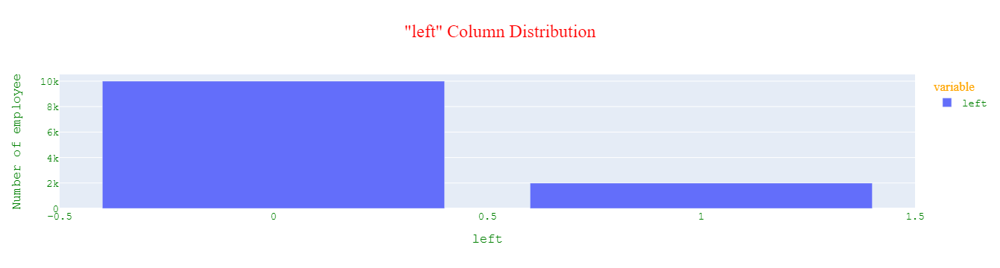

In [97]:
# with plotly

fig = px.bar(df['left'].value_counts(),
             labels={"index": "left", "value":"Number of employee"},
             title = '"left" Column Distribution')
fig.update_layout(width=500,
                  height=300,
                  title_x=0.5,
                  font_family="Courier New", 
                  font_color="green",
                  font_size=14,
                  title_font_family="Times New Roman", 
                  title_font_color="red",
                  title_font_size=24,
                  legend_title_font_family='calibre',
                  legend_title_font_color="orange")
fig.show()

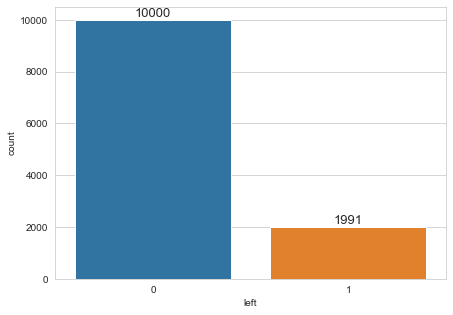

In [98]:
# with seaborn
plt.figure(figsize = (7,5))
sns.countplot(data = df, x = 'left');
for index,value in enumerate(df.left.value_counts()):
    plt.text(index, value, f'{value}', ha = 'center', va = 'bottom', fontsize = 13);

"left" Column Distribution


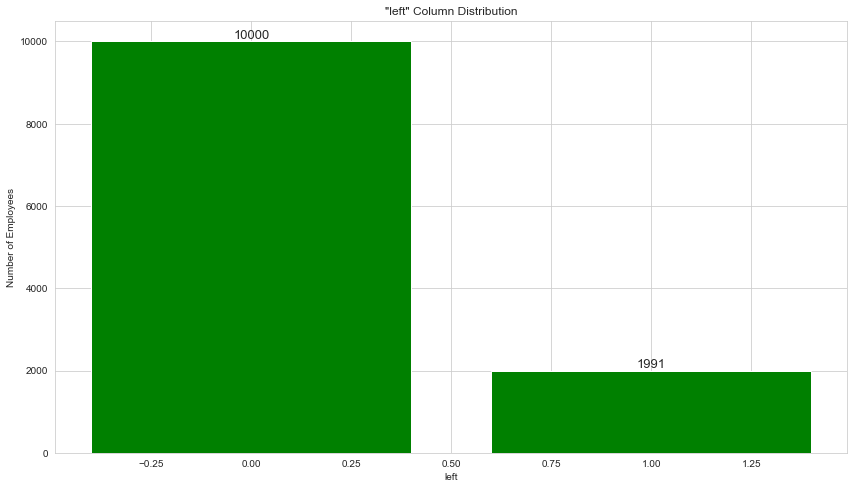

In [99]:
# with matplotlib
cprint('"left" Column Distribution','green')
fig = plt.figure(figsize = (11,6))
ax = fig.add_axes([0,0,1,1])
ax.bar(df.left.value_counts().index, df.left.value_counts().values, color = 'green')
plt.title('"left" Column Distribution')   
plt.xlabel('left') 
plt.ylabel('Number of Employees') 
for index,value in enumerate(df.left.value_counts()):
    plt.text(index, value, f'{value}', ha = 'center', va = 'bottom', fontsize = 13)
plt.show()

### Number of Projects

Similarly, we can also plot a bar graph to count the number of employees deployed on how many projects?

In [101]:
cprint('"number_project" Column Distribution','green')
df.number_project.value_counts()

"number_project" Column Distribution


4    3685
3    3520
5    2233
2    1582
6     826
7     145
Name: number_project, dtype: int64

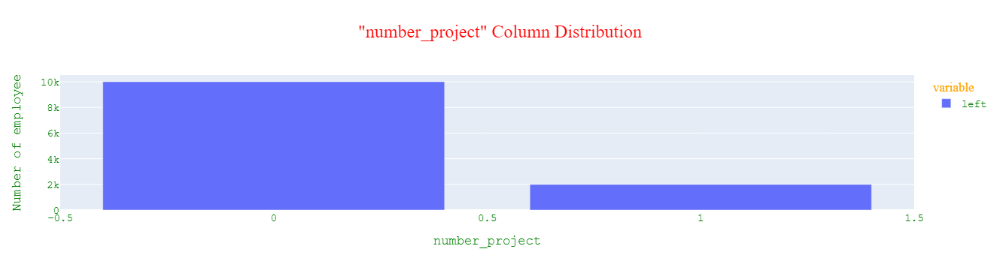

In [102]:
# with plotly
fig = px.bar(df['left'].value_counts(),
             labels={"index": "number_project", "value":"Number of employee"},
             title = '"number_project" Column Distribution')
fig.update_layout(width=500,
                  height=300,
                  title_x=0.5,
                  font_family="Courier New", 
                  font_color="green",
                  font_size=14,
                  title_font_family="Times New Roman", 
                  title_font_color="red",
                  title_font_size=24,
                  legend_title_font_family='calibre',
                  legend_title_font_color="orange")
fig.show()

In [103]:
df.number_project.value_counts()

4    3685
3    3520
5    2233
2    1582
6     826
7     145
Name: number_project, dtype: int64

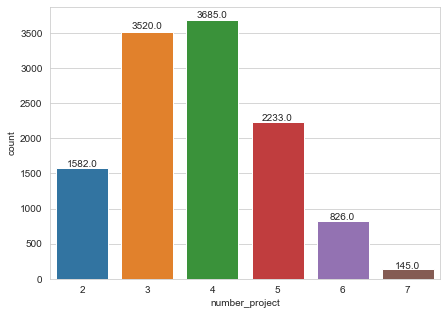

In [104]:
# with seaborn

# Show Values on Seaborn Barplot
def show_values(axs, orient="v", space=.01):
    def _single(ax):
        if orient == "v":
            for p in ax.patches:
                _x = p.get_x() + p.get_width() / 2
                _y = p.get_y() + p.get_height() + (p.get_height()*0.01)
                value = '{:.1f}'.format(p.get_height())
                ax.text(_x, _y, value, ha="center") 
        elif orient == "h":
            for p in ax.patches:
                _x = p.get_x() + p.get_width() + float(space)
                _y = p.get_y() + p.get_height() - (p.get_height()*0.5)
                value = '{:.1f}'.format(p.get_width())
                ax.text(_x, _y, value, ha="left")

    if isinstance(axs, np.ndarray):
        for idx, ax in np.ndenumerate(axs):
            _single(ax)
    else:
        _single(axs)
plt.figure(figsize = (7,5))
ax = sns.countplot(data = df, x = 'number_project');
show_values(ax)

"number_project" Column Distribution


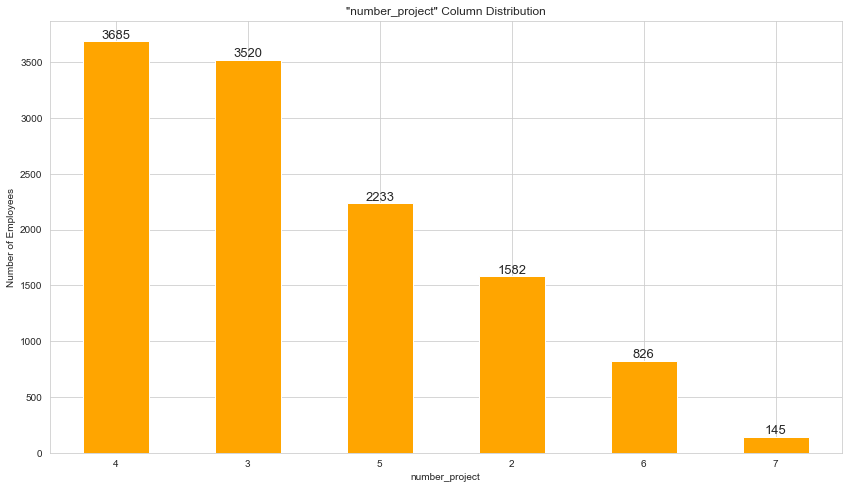

In [105]:
cprint('"number_project" Column Distribution','green')
fig = plt.figure(figsize = (11,6))
ax = fig.add_axes([0,0,1,1])
# x = df.number_project.value_counts().index
# y = df.number_project.value_counts().values
df.number_project.value_counts().plot(kind = "bar", color = "orange")
plt.title('"number_project" Column Distribution')   
plt.xlabel('number_project') 
plt.ylabel('Number of Employees')
plt.xticks(rotation = 0)
for index,value in enumerate(df.number_project.value_counts().sort_values(ascending=False)):
    plt.text(index, value, f'{value}', ha = 'center', va = 'bottom', fontsize = 13)
plt.show()

### Time Spent in Company

Similarly, we can also plot a bar graph to count the number of employees have based on how much experience?


In [106]:
cprint('"time_spend_company" Column Distribution','green')
df.time_spend_company.value_counts()

"time_spend_company" Column Distribution


3     5190
2     2910
4     2005
5     1062
6      542
10     107
7       94
8       81
Name: time_spend_company, dtype: int64

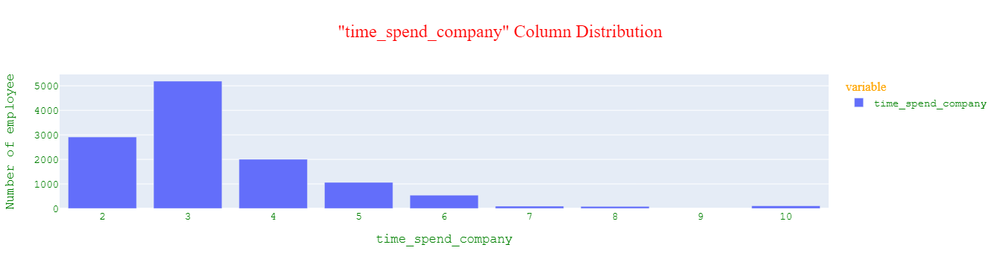

In [107]:
# with plotly
# df['time_spend_company'].value_counts().iplot(kind="bar", title = '"time_spend_company" Column Distribution')

fig = px.bar(df['time_spend_company'].value_counts(),
             labels={"index": "time_spend_company", "value":"Number of employee"},
             title = '"time_spend_company" Column Distribution')
fig.update_layout(width=500,
                  height=300,
                  title_x=0.5,
                  font_family="Courier New", 
                  font_color="green",
                  font_size=14,
                  title_font_family="Times New Roman", 
                  title_font_color="red",
                  title_font_size=24,
                  legend_title_font_family='calibre',
                  legend_title_font_color="orange")
fig.show()

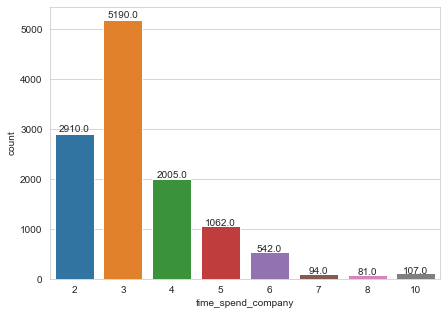

In [108]:
# with seaborn

plt.figure(figsize = (7,5))
ax = sns.countplot(data = df, x = 'time_spend_company');
show_values(ax)

"time_spend_company" Column Distribution


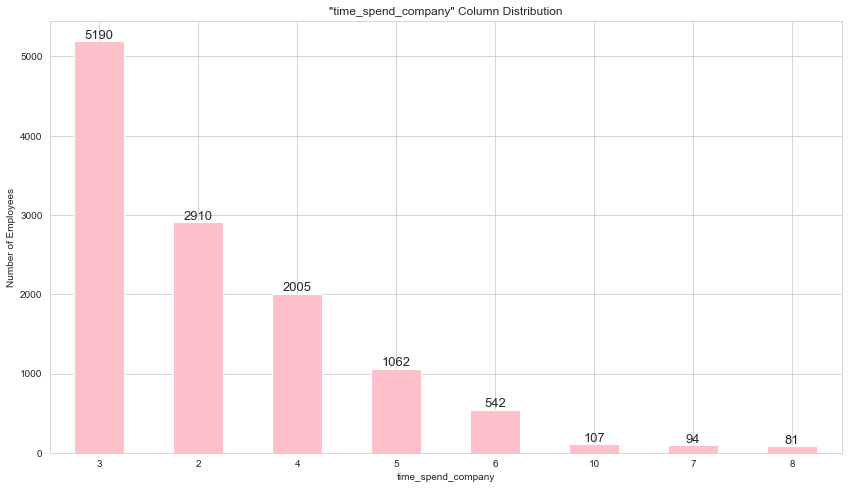

In [109]:
# with matplotlib
cprint('"time_spend_company" Column Distribution','green','on_red')
fig = plt.figure(figsize = (11,6))
ax = fig.add_axes([0,0,1,1])
df.time_spend_company.value_counts().plot(kind = "bar", color = "pink")
plt.title('"time_spend_company" Column Distribution')   
plt.xlabel('time_spend_company') 
plt.ylabel('Number of Employees')
plt.xticks(rotation = 0)
for index,value in enumerate(df.time_spend_company.value_counts().sort_values(ascending=False)):
    plt.text(index, value, f'{value}', ha = 'center', va = 'bottom', fontsize = 13)
plt.show()

### Subplots of Features

We can use the methods of the matplotlib.

In [110]:
# for i in df:
#     df[i].iplot(kind = 'histogram', subplots = True, bins = 50)

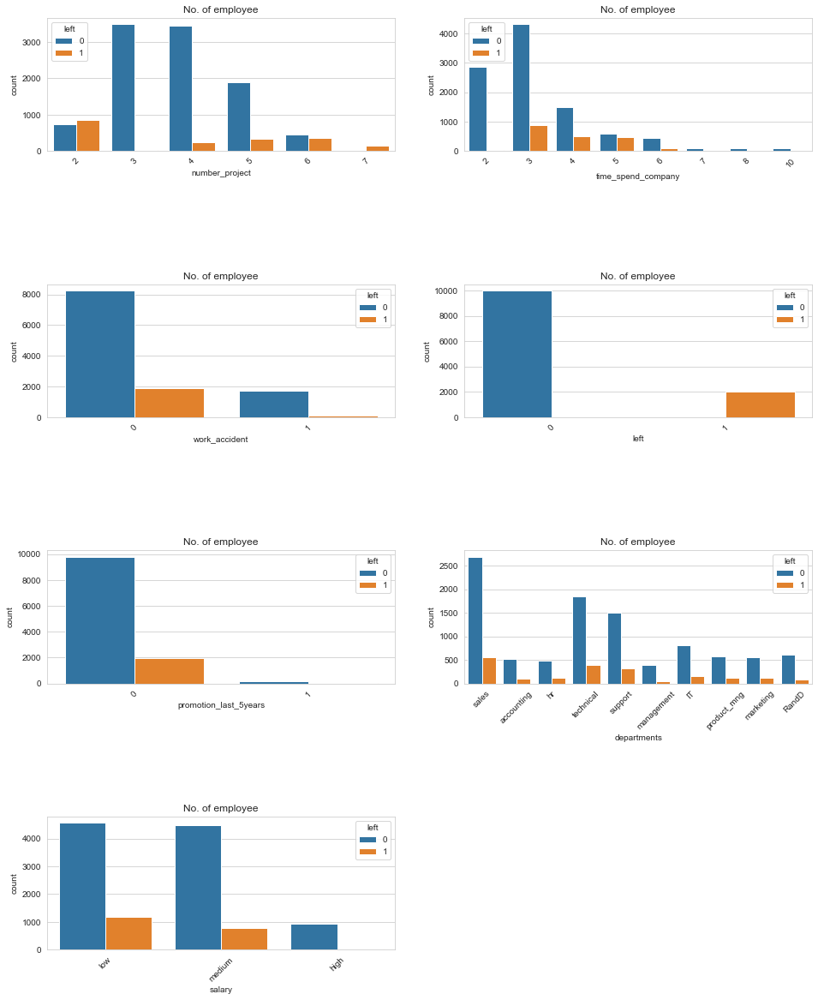

In [111]:
features=['number_project','time_spend_company','work_accident','left', 'promotion_last_5years','departments','salary']
fig=plt.subplots(figsize=(16,20))
for i, j in enumerate(features):
    plt.subplot(4, 2, i+1)
    plt.subplots_adjust(hspace = 1.0)
    sns.countplot(x=j,data = df,hue='left')
    plt.xticks(rotation=45)
    plt.title("No. of employee")

## 3. Data Pre-Processing

- Scaling
- Label Encoding
----------

#### Label Encoding

Lots of machine learning algorithms require numerical input data, so we need to represent categorical columns in a numerical column. In order to encode this data, we could map each value to a number. e.g. Salary column's value can be represented as low:0, medium:1, and high:2. This process is known as label encoding, and sklearn conveniently will do this for our using LabelEncoder. We can also use get_dummies and one_hot_encoder.

A comparison between label_encoder and one_hot_encoder:
https://towardsdatascience.com/categorical-encoding-using-label-encoding-and-one-hot-encoder-911ef77fb5bd

In [125]:
df1 = df.drop('left', axis = 1)
df1.head(2)

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,departments,salary
0,0.380,0.530,2,157,3,0,0,sales,low
1,0.800,0.860,5,262,6,0,0,sales,medium


In [127]:
df1 = pd.get_dummies(df1, drop_first = True)
df1.head(2)

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,departments_RandD,departments_accounting,departments_hr,departments_management,departments_marketing,departments_product_mng,departments_sales,departments_support,departments_technical,salary_low,salary_medium
0,0.380,0.530,2,157,3,0,0,0,0,0,0,0,0,1,0,0,1,0
1,0.800,0.860,5,262,6,0,0,0,0,0,0,0,0,1,0,0,0,1


#### Scaling

Some machine learning algorithms are sensitive to feature scaling while others are virtually invariant to it. Machine learning algorithms like linear regression, logistic regression, neural network, etc. that use gradient descent as an optimization technique require data to be scaled. Also distance algorithms like KNN, K-means, and SVM are most affected by the range of features. This is because behind the scenes they are using distances between data points to determine their similarity.

Scaling Types:
- Normalization: Normalization is a scaling technique in which values are shifted and rescaled so that they end up ranging between 0 and 1. It is also known as Min-Max scaling.

- Standardization: Standardization is another scaling technique where the values are centered around the mean with a unit standard deviation. This means that the mean of the attribute becomes zero and the resultant distribution has a unit standard deviation.

    

In [129]:
df1.head()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,departments_RandD,departments_accounting,departments_hr,departments_management,departments_marketing,departments_product_mng,departments_sales,departments_support,departments_technical,salary_low,salary_medium
0,0.380,0.530,2,157,3,0,0,0,0,0,0,0,0,1,0,0,1,0
1,0.800,0.860,5,262,6,0,0,0,0,0,0,0,0,1,0,0,0,1
2,0.110,0.880,7,272,4,0,0,0,0,0,0,0,0,1,0,0,0,1
3,0.720,0.870,5,223,5,0,0,0,0,0,0,0,0,1,0,0,1,0
4,0.370,0.520,2,159,3,0,0,0,0,0,0,0,0,1,0,0,1,0


In [130]:
scaler = MinMaxScaler()
scaler.fit(df1)
#Store it separately for clustering
df1_scaled= scaler.transform(df1)

In [131]:
df1_scaled

array([[0.31868132, 0.265625  , 0.        , ..., 0.        , 1.        ,
        0.        ],
       [0.78021978, 0.78125   , 0.6       , ..., 0.        , 0.        ,
        1.        ],
       [0.02197802, 0.8125    , 1.        , ..., 0.        , 0.        ,
        1.        ],
       ...,
       [0.83516484, 0.28125   , 0.2       , ..., 0.        , 0.        ,
        0.        ],
       [0.26373626, 0.453125  , 0.2       , ..., 0.        , 0.        ,
        0.        ],
       [0.45054945, 0.578125  , 0.4       , ..., 0.        , 1.        ,
        0.        ]])

In [137]:
df1_scaled.shape

(11991, 18)

## 4. Cluster Analysis

- Find the optimal number of clusters (k) using the elbow method for for K-means.
- Determine the clusters by using K-Means then Evaluate predicted results.
---------

- Cluster analysis or clustering is the task of grouping a set of objects in such a way that objects in the same group (called a cluster) are more similar (in some sense) to each other than to those in other groups (clusters). It is a main task of exploratory data mining, and a common technique for statistical data analysis, used in many fields, including pattern recognition, image analysis, information retrieval, bioinformatics, data compression, computer graphics and machine learning.

    [Cluster Analysis](https://en.wikipedia.org/wiki/Cluster_analysis)

    [Cluster Analysis2](https://realpython.com/k-means-clustering-python/)

#### The Elbow Method

- "Elbow Method" can be used to find the optimum number of clusters in cluster analysis. The elbow method is used to determine the optimal number of clusters in k-means clustering. The elbow method plots the value of the cost function produced by different values of k. If k increases, average distortion will decrease, each cluster will have fewer constituent instances, and the instances will be closer to their respective centroids. However, the improvements in average distortion will decline as k increases. The value of k at which improvement in distortion declines the most is called the elbow, at which we should stop dividing the data into further clusters.

    [The Elbow Method](https://en.wikipedia.org/wiki/Elbow_method_(clustering)

    [The Elbow Method2](https://medium.com/@mudgalvivek2911/machine-learning-clustering-elbow-method-4e8c2b404a5d)

    [KMeans](https://towardsdatascience.com/understanding-k-means-clustering-in-machine-learning-6a6e67336aa1)

Let's find out the groups of employees who left. We can observe that the most important factor for any employee to stay or leave is satisfaction and performance in the company. So let's bunch them in the group of people using cluster analysis.

In [138]:
df1.shape

(11991, 18)

**Hopkins test**

A statistical test which allow to guess if the data follow an uniform distribution. If the test is positve (an hopkins score which tends to 0) it means that the data is not uniformly distributed. Hence clustering can be useful to classify the observations. However, if the score is too high (above 0.3 for exemple); the data is uniformly distributed and clustering can’t be really useful for the problem at hand.

In [140]:
from pyclustertend import hopkins
hopkins(df1_scaled,df1.shape[0])

0.08285244892019508

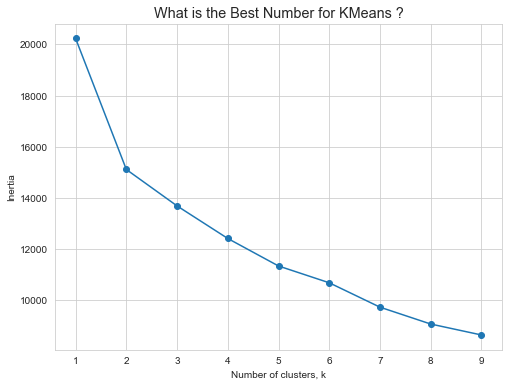

In [141]:
#First : Get the Best KMeans 
from sklearn.cluster import KMeans

ks = range(1,10)
inertias=[]
for k in ks :
    # Create a KMeans clusters
    kc = KMeans(n_clusters=k,random_state=1)
    kc.fit(df1_scaled)
    inertias.append(kc.inertia_)

# Plot ks vs inertias
f, ax = plt.subplots(figsize=(8, 6))
plt.plot(ks, inertias, '-o')
plt.xlabel('Number of clusters, k')
plt.ylabel('Inertia')
plt.xticks(ks)
plt.style.use('ggplot')
plt.title('What is the Best Number for KMeans ?')
plt.show()

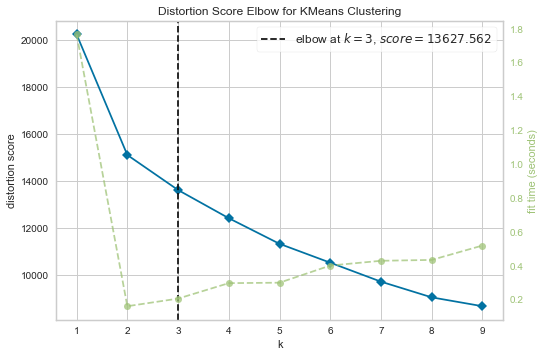

In [142]:
from yellowbrick.cluster import KElbowVisualizer
kmeans = KMeans()
visu = KElbowVisualizer(kmeans, k = (1,10))
visu.fit(df1_scaled)
visu.show();

**What is a good silhouette score?**

The value of the silhouette coefﬁcient is between [-1, 1]. A score of 1 denotes the best meaning that the data point i is very compact within the cluster to which it belongs and far away from the other clusters. The worst value is -1. Values near 0 denote overlapping clusters.

https://www.analyticsvidhya.com/blog/2021/05/k-mean-getting-the-optimal-number-of-clusters/

In [143]:
from sklearn.metrics import silhouette_samples,silhouette_score
ssd =[]

K = range(2,10)

for k in K:
    model = KMeans(n_clusters=k)
    model.fit(df1_scaled)
    ssd.append(model.inertia_)
    print(f'Silhouette Score for {k} clusters: {silhouette_score(df1_scaled, model.labels_)}')

Silhouette Score for 2 clusters: 0.24293849820807237
Silhouette Score for 3 clusters: 0.19250986825854602
Silhouette Score for 4 clusters: 0.18068273720847766
Silhouette Score for 5 clusters: 0.20913615663599136
Silhouette Score for 6 clusters: 0.24421933609012644
Silhouette Score for 7 clusters: 0.2686037509709165
Silhouette Score for 8 clusters: 0.29761183406668895
Silhouette Score for 9 clusters: 0.2969056292079459


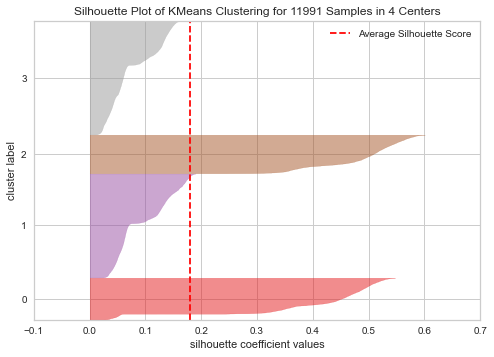

In [144]:
from sklearn.cluster import KMeans

from yellowbrick.cluster import SilhouetteVisualizer

model_4 = KMeans(n_clusters=4, random_state=101)
visualizer = SilhouetteVisualizer(model_4)
visualizer.fit(df1_scaled)    # Fit the data to the visualizer
visualizer.poof();

In [145]:
k_means_model = KMeans(n_clusters = 4, random_state = 101)
k_means_model.fit_predict(df1_scaled)
labels = k_means_model.labels_
labels

array([2, 0, 0, ..., 3, 3, 1])

In [146]:
df['predicted_clusters'] = labels
df

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,departments,salary,left,predicted_clusters
0,0.380,0.530,2,157,3,0,0,sales,low,1,2
1,0.800,0.860,5,262,6,0,0,sales,medium,1,0
2,0.110,0.880,7,272,4,0,0,sales,medium,1,0
3,0.720,0.870,5,223,5,0,0,sales,low,1,2
4,0.370,0.520,2,159,3,0,0,sales,low,1,2
...,...,...,...,...,...,...,...,...,...,...,...
11995,0.900,0.550,3,259,10,1,1,management,high,0,3
11996,0.740,0.950,5,266,10,0,1,management,high,0,3
11997,0.850,0.540,3,185,10,0,1,management,high,0,3
11998,0.330,0.650,3,172,10,0,1,marketing,high,0,3


In [147]:
df['predicted_clusters'].value_counts()

3    4565
1    4187
0    1686
2    1553
Name: predicted_clusters, dtype: int64

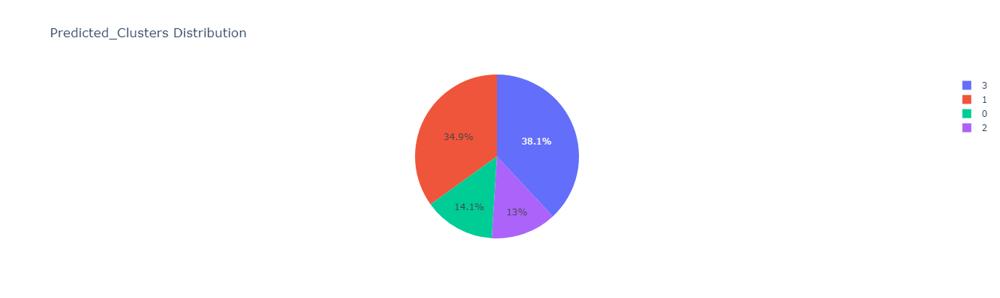

In [148]:
fig = px.pie(df, values = df['predicted_clusters'].value_counts(), 
             names = (df['predicted_clusters'].value_counts()).index, 
             title = 'Predicted_Clusters Distribution',
             width=800, 
             height=400)
fig
fig.show()

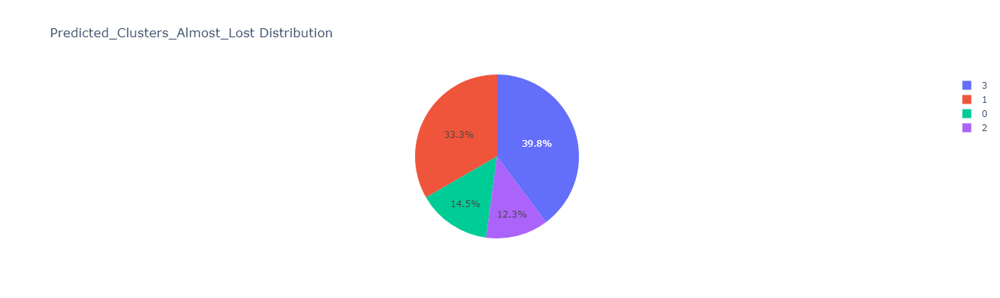

In [149]:
fig = px.pie(df, values = df[df['left']==0]['predicted_clusters'].value_counts(), 
             names = df[df['left']==0]['predicted_clusters'].value_counts().index, 
             title = 'Predicted_Clusters_Almost_Lost Distribution',
             width=800, 
             height=400)
fig.show()

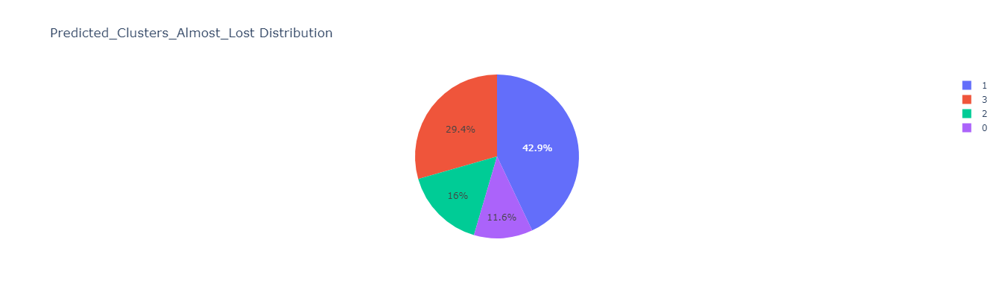

In [150]:
fig = px.pie(df, values = df[df['left']==1]['predicted_clusters'].value_counts(), 
             names = df[df['left']==1]['predicted_clusters'].value_counts().index, 
             title = 'Predicted_Clusters_Almost_Lost Distribution',
             width=800, 
             height=400)
fig.show()

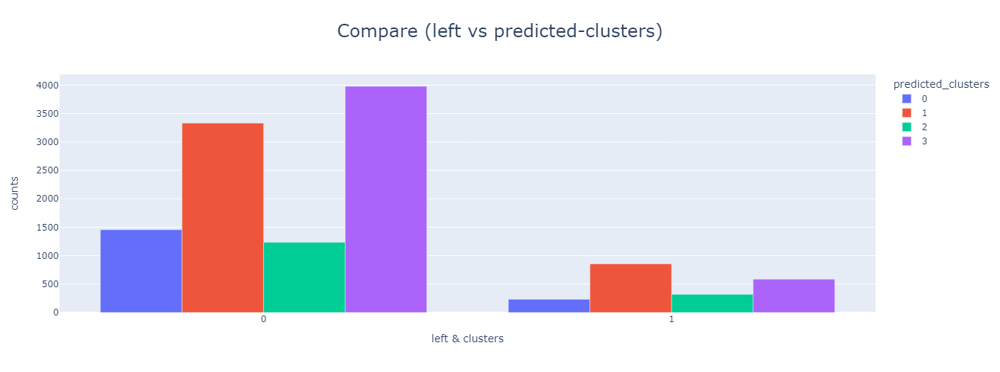

In [151]:
fig = px.bar(data_frame = pd.crosstab(df['left'], df['predicted_clusters']), 
             title = 'Compare (left vs predicted-clusters)',
             labels={"left": "left & clusters", "value":"counts"},
             barmode='group')
fig.update_layout(width=1400,
                  height=500,
                  title_x=0.5,
                  title_font_size=24,)
fig.show()

In [152]:
df.groupby('left').mean()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,predicted_clusters
left,,,,,,,,
0,0.667,0.716,3.787,198.943,3.262,0.174,0.019,1.774
1,0.440,0.722,3.883,208.162,3.881,0.053,0.004,1.633


In [153]:
cprint('Dataset describe results according to the "left==1" condition','green')
df.groupby(['left', 'predicted_clusters']).mean()

Dataset describe results according to the "left==1" condition


satisfaction_level  last_evaluation  number_project  \
left predicted_clusters                                                        
0    0                                0.669            0.710           3.775   
     1                                0.670            0.721           3.785   
     2                                0.668            0.709           3.786   
     3                                0.664            0.716           3.793   
1    0                                0.424            0.720           3.883   
     1                                0.430            0.725           3.935   
     2                                0.469            0.713           3.677   
     3                                0.446            0.723           3.922   

                         average_montly_hours  time_spend_company  \
left predicted_clusters                                             
0    0                                199.383               3.377   
     1                                198.706               3.171   
     2                                198.568               3.190   
     3                                199.096               3.319   
1    0                                210.857               3.818   
     1                                208.957               3.899   
     2                                202.950               3.821   
     3                                208.778               3.913   

                         work_accident  promotion_last_5years  
left predicted_clusters                                        
0    0                           0.173                  0.033  
     1                           0.185                  0.008  
     2                           0.174                  0.006  
     3                           0.166                  0.029  
1    0                           0.078                  0.004  
     1                           0.051                  0.004  
     2                           0.041                  0.006  
     3                           0.051                  0.003

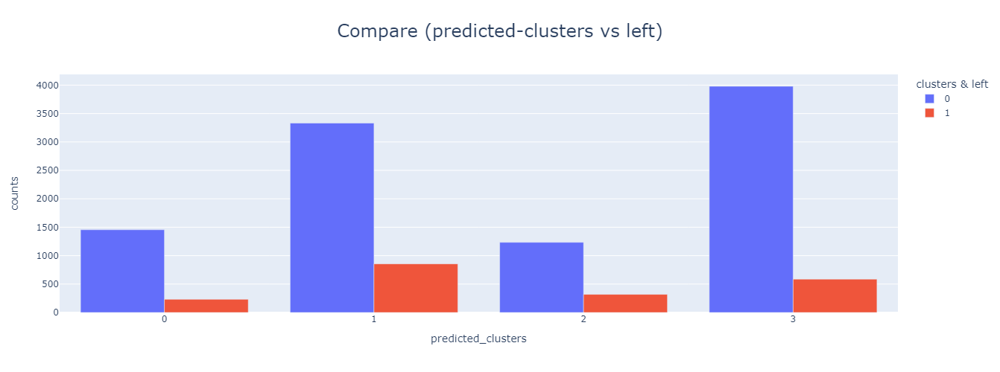

In [154]:
fig = px.bar(data_frame = pd.crosstab(df['predicted_clusters'], df['left']), 
             title = 'Compare (predicted-clusters vs left)',
             labels={"left": "clusters & left", "value":"counts"},
             barmode='group')
fig.update_layout(width=1400,
                  height=500,
                  title_x=0.5,
                  title_font_size=24,)
fig.show()

In [155]:
df.left.value_counts()

0    10000
1     1991
Name: left, dtype: int64

In [157]:
# cprint('Dataset describe results according to the "left==1" condition','green')
df.groupby('predicted_clusters').mean()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,left
predicted_clusters,,,,,,,,
0,0.635,0.711,3.789,200.955,3.437,0.160,0.029,0.137
1,0.621,0.722,3.816,200.799,3.320,0.158,0.007,0.204
2,0.627,0.710,3.764,199.468,3.319,0.147,0.006,0.205
3,0.636,0.716,3.809,200.339,3.395,0.151,0.025,0.128


In [159]:
# cprint('Dataset describe results according to the "left==1" condition','green')
df.groupby(['predicted_clusters', 'left']).mean()

satisfaction_level  last_evaluation  number_project  \
predicted_clusters left                                                        
0                  0                  0.669            0.710           3.775   
                   1                  0.424            0.720           3.883   
1                  0                  0.670            0.721           3.785   
                   1                  0.430            0.725           3.935   
2                  0                  0.668            0.709           3.786   
                   1                  0.469            0.713           3.677   
3                  0                  0.664            0.716           3.793   
                   1                  0.446            0.723           3.922   

                         average_montly_hours  time_spend_company  \
predicted_clusters left                                             
0                  0                  199.383               3.377   
                   1                  210.857               3.818   
1                  0                  198.706               3.171   
                   1                  208.957               3.899   
2                  0                  198.568               3.190   
                   1                  202.950               3.821   
3                  0                  199.096               3.319   
                   1                  208.778               3.913   

                         work_accident  promotion_last_5years  
predicted_clusters left                                        
0                  0             0.173                  0.033  
                   1             0.078                  0.004  
1                  0             0.185                  0.008  
                   1             0.051                  0.004  
2                  0             0.174                  0.006  
                   1             0.041                  0.006  
3                  0             0.166                  0.029  
                   1             0.051                  0.003

___

## 5. Model Building

- Split Data as Train and Test set
- Built Gradient Boosting Classifier, Evaluate Model Performance and Predict Test Data
- Built K Neighbors Classifier and Evaluate Model Performance and Predict Test Data
- Built Random Forest Classifier and Evaluate Model Performance and Predict Test Data
---------

#### Evaluating Model Performance

- Confusion Matrix : You can use scikit-learn metrics module for accuracy calculation. A Confusion matrix is an N x N matrix used for evaluating the performance of a classification model, where N is the number of target classes. The matrix compares the actual target values with those predicted by the machine learning model. This gives us a holistic view of how well our classification model is performing and what kinds of errors it is making.

    [Confusion Matrix](https://www.analyticsvidhya.com/blog/2020/04/confusion-matrix-machine-learning/)

- Yellowbrick: Yellowbrick is a suite of visualization and diagnostic tools that will enable quicker model selection. It’s a Python package that combines scikit-learn and matplotlib. Some of the more popular visualization tools include model selection, feature visualization, classification and regression visualization

    [Yellowbrick](https://www.analyticsvidhya.com/blog/2018/05/yellowbrick-a-set-of-visualization-tools-to-accelerate-your-model-selection-process/)

### Split Data as Train and Test Set

Here, Dataset is broken into two parts in ratio of 70:30. It means 70% data will used for model training and 30% for model testing.

In [160]:
cprint('New df for Classification','green')
df2 = df.drop('predicted_clusters', axis = 1)
df2.head(2)

New df for Classification


,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,departments,salary,left
0,0.380,0.530,2,157,3,0,0,sales,low,1
1,0.800,0.860,5,262,6,0,0,sales,medium,1


In [161]:
df2.columns

Index(['satisfaction_level', 'last_evaluation', 'number_project',
       'average_montly_hours', 'time_spend_company', 'work_accident',
       'promotion_last_5years', 'departments', 'salary', 'left'],
      dtype='object')

In [162]:
df2 = pd.get_dummies(df2, columns = ['departments','salary'], drop_first = True)
df2.head(1)

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,left,departments_RandD,departments_accounting,departments_hr,departments_management,departments_marketing,departments_product_mng,departments_sales,departments_support,departments_technical,salary_low,salary_medium
0,0.380,0.530,2,157,3,0,0,1,0,0,0,0,0,0,1,0,0,1,0


In [163]:
df2.columns

Index(['satisfaction_level', 'last_evaluation', 'number_project',
       'average_montly_hours', 'time_spend_company', 'work_accident',
       'promotion_last_5years', 'left', 'departments_RandD',
       'departments_accounting', 'departments_hr', 'departments_management',
       'departments_marketing', 'departments_product_mng', 'departments_sales',
       'departments_support', 'departments_technical', 'salary_low',
       'salary_medium'],
      dtype='object')

In [164]:
# # I decided to continue with these columns --> FEATURE SELECTION
# # Getting the highest score with the least data from the user --> (TRADE-OFF)
# df2 = df2[['satisfaction_level', 'last_evaluation', 'number_project',
#        'average_montly_hours', 'time_spend_company', 'left',]]

In [165]:
df2.head()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,left,departments_RandD,departments_accounting,departments_hr,departments_management,departments_marketing,departments_product_mng,departments_sales,departments_support,departments_technical,salary_low,salary_medium
0,0.380,0.530,2,157,3,0,0,1,0,0,0,0,0,0,1,0,0,1,0
1,0.800,0.860,5,262,6,0,0,1,0,0,0,0,0,0,1,0,0,0,1
2,0.110,0.880,7,272,4,0,0,1,0,0,0,0,0,0,1,0,0,0,1
3,0.720,0.870,5,223,5,0,0,1,0,0,0,0,0,0,1,0,0,1,0
4,0.370,0.520,2,159,3,0,0,1,0,0,0,0,0,0,1,0,0,1,0


In [166]:
X = df2.drop('left', axis = 1)
y = df2['left']

In [167]:
from sklearn.model_selection import RepeatedStratifiedKFold, KFold, cross_val_predict, train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify = y, test_size = 0.3, random_state = 101)

In [168]:
scaler = MinMaxScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [169]:
def eval(model, X_train, X_test):
    y_pred = model.predict(X_test)
    y_pred_train = model.predict(X_train)
    
    print(confusion_matrix(y_test, y_pred))
    print("Test_Set")
    print(classification_report(y_test,y_pred))
    print("Train_Set")
    print(classification_report(y_train,y_pred_train))
    plot_confusion_matrix(model, X_test, y_test, cmap="plasma")

In [170]:
def train_val(y_train, y_train_pred, y_test, y_pred):
    
    scores = {"train_set": {"Accuracy" : accuracy_score(y_train, y_train_pred),
                            "Precision" : precision_score(y_train, y_train_pred),
                            "Recall" : recall_score(y_train, y_train_pred),                          
                            "f1" : f1_score(y_train, y_train_pred)},
    
              "test_set": {"Accuracy" : accuracy_score(y_test, y_pred),
                           "Precision" : precision_score(y_test, y_pred),
                           "Recall" : recall_score(y_test, y_pred),                          
                           "f1" : f1_score(y_test, y_pred)}}
    
    return pd.DataFrame(scores)

### Gradient Boosting Classifier

#### Model Building

In [171]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import plot_roc_curve, roc_auc_score, roc_curve, f1_score, accuracy_score, recall_score
GB_model = GradientBoostingClassifier(random_state = 101)
GB_model.fit(X_train, y_train)
y_pred = GB_model.predict(X_test)
y_train_pred = GB_model.predict(X_train)

GB_model_f1 = f1_score(y_test, y_pred)
GB_model_acc = accuracy_score(y_test, y_pred)
GB_model_recall = recall_score(y_test, y_pred)
GB_model_auc = roc_auc_score(y_test, y_pred)

#### Evaluating Model Performance

GB_Model
------------------
[[2974   27]
 [  45  552]]
Test_Set
              precision    recall  f1-score   support

           0       0.99      0.99      0.99      3001
           1       0.95      0.92      0.94       597

    accuracy                           0.98      3598
   macro avg       0.97      0.96      0.96      3598
weighted avg       0.98      0.98      0.98      3598

Train_Set
              precision    recall  f1-score   support

           0       0.99      0.99      0.99      6999
           1       0.97      0.93      0.95      1394

    accuracy                           0.98      8393
   macro avg       0.98      0.96      0.97      8393
weighted avg       0.98      0.98      0.98      8393



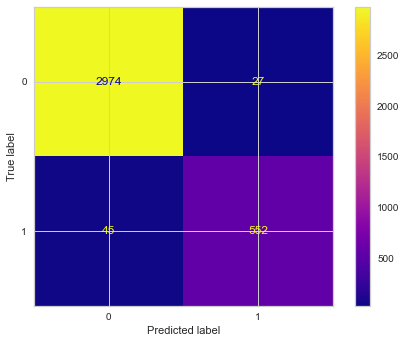

In [172]:
from sklearn.metrics import plot_confusion_matrix, r2_score, mean_absolute_error, mean_squared_error, classification_report 
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report
print("GB_Model")
print ("------------------")
eval(GB_model, X_train, X_test)

In [173]:
from sklearn.metrics import make_scorer, precision_score, precision_recall_curve, plot_precision_recall_curve 
from sklearn.metrics import plot_roc_curve, roc_auc_score, roc_curve, f1_score, accuracy_score, recall_score
train_val(y_train, y_train_pred, y_test, y_pred)

,train_set,test_set
Accuracy,0.983,0.980
Precision,0.969,0.953
Recall,0.928,0.925
f1,0.948,0.939


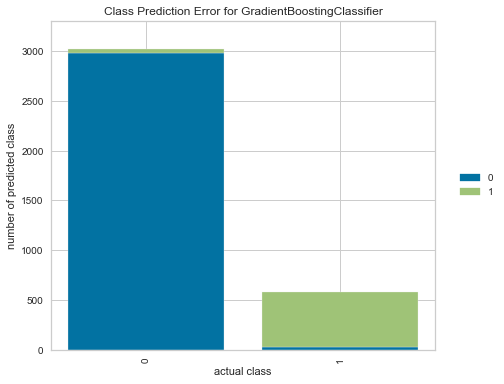

In [174]:
from yellowbrick.classifier import ClassPredictionError

visualizer = ClassPredictionError(GB_model)

# Fit the training data to the visualizer
visualizer.fit(X_train, y_train)

# Evaluate the model on the test data
visualizer.score(X_test, y_test)

# Draw visualization
visualizer.poof();

#### Feature Importance for Gradient Boosting Model

In [175]:
GB_feature_imp = pd.DataFrame(index=X.columns, data = GB_model.feature_importances_, columns = ['Importance']).sort_values("Importance", ascending = False)
GB_feature_imp

,Importance
satisfaction_level,0.527
number_project,0.138
time_spend_company,0.137
last_evaluation,0.122
average_montly_hours,0.075
salary_low,0.001
work_accident,0.000
departments_management,0.000
departments_product_mng,0.000
departments_RandD,0.000


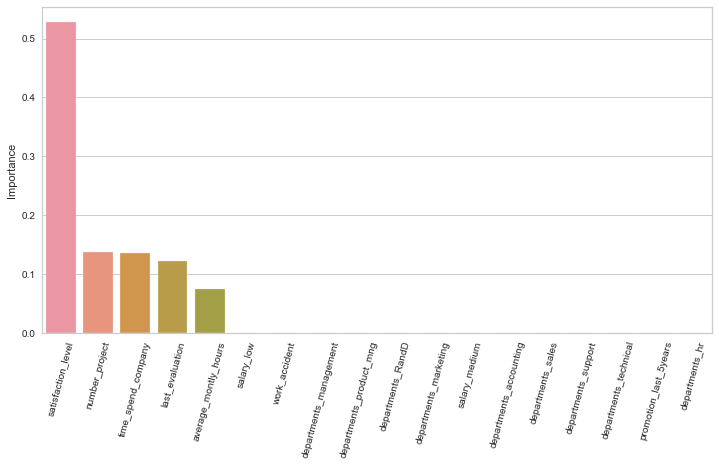

In [176]:
plt.figure(figsize = (12,6))
sns.barplot(data = GB_feature_imp.sort_values('Importance', ascending = False), x = GB_feature_imp.sort_values('Importance', ascending = False).index, y = 'Importance')
plt.xticks(rotation = 75);

#### Gradient Boosting Classifier Cross Validation

In [177]:
from sklearn.model_selection import StratifiedKFold, GridSearchCV, cross_val_score, cross_validate
GB_cv = GradientBoostingClassifier(random_state = 101)

GB_cv_scores = cross_validate(GB_cv, X_train, y_train, 
                              scoring = ['accuracy', 'precision','recall', 'f1', 'roc_auc'], cv = 10)
GB_cv_scores = pd.DataFrame(GB_cv_scores, index = range(1, 11))

GB_cv_scores.mean()[2:]

test_accuracy    0.981
test_precision   0.965
test_recall      0.922
test_f1          0.943
test_roc_auc     0.985
dtype: float64

#### Gradient Boosting Classifier GridSearchCV

In [179]:
param_grid = {"n_estimators":[100, 200, 300],
              "subsample":[0.5, 1], 
              "max_features" : [None, 2, 3, 4],
              "learning_rate": [0.001, 0.01, 0.1], 
              'max_depth':[3, 4, 5, 6]} 

In [180]:
GB_grid = GradientBoostingClassifier(random_state = 101)
GB_grid_model = GridSearchCV(GB_grid, param_grid, scoring = "f1", verbose = 2, n_jobs = -1).fit(X_train, y_train)

Fitting 5 folds for each of 288 candidates, totalling 1440 fits


In [181]:
GB_grid_model.best_estimator_

GradientBoostingClassifier(learning_rate=0.01, max_depth=6, n_estimators=200,
                           random_state=101, subsample=0.5)

In [183]:
print(colored('\033[1mBest Parameters of GridSearchCV for Gradient Boosting Model:\033[0m', 'blue'), colored(GB_grid_model.best_params_, 'green'))
print(colored('*'*100, 'red', attrs = ['bold']), sep = '')
print(colored('\033[1mBest Estimator of GridSearchCV for Gradient Boosting Model:\033[0m', 'blue'), colored(GB_grid_model.best_estimator_, 'green'))

Best Parameters of GridSearchCV for Gradient Boosting Model: {'learning_rate': 0.01, 'max_depth': 6, 'max_features': None, 'n_estimators': 200, 'subsample': 0.5}
****************************************************************************************************
Best Estimator of GridSearchCV for Gradient Boosting Model: GradientBoostingClassifier(learning_rate=0.01, max_depth=6, n_estimators=200,
                           random_state=101, subsample=0.5)


In [185]:
GB_tuned = GradientBoostingClassifier(learning_rate = 0.01,
                                      max_depth = 6, 
                                      n_estimators = 200,
                                      subsample = 0.5,
                                      random_state = 101).fit(X_train, y_train)

In [186]:
y_pred = GB_tuned.predict(X_test)
y_train_pred = GB_tuned.predict(X_train)

GB_tuned_f1 = f1_score(y_test, y_pred)
GB_tuned_acc = accuracy_score(y_test, y_pred)
GB_tuned_recall = recall_score(y_test, y_pred)
GB_tuned_auc = roc_auc_score(y_test, y_pred)

GB_tuned
------------------
[[2994    7]
 [  48  549]]
Test_Set
              precision    recall  f1-score   support

           0       0.98      1.00      0.99      3001
           1       0.99      0.92      0.95       597

    accuracy                           0.98      3598
   macro avg       0.99      0.96      0.97      3598
weighted avg       0.98      0.98      0.98      3598

Train_Set
              precision    recall  f1-score   support

           0       0.99      1.00      0.99      6999
           1       0.99      0.93      0.96      1394

    accuracy                           0.99      8393
   macro avg       0.99      0.96      0.97      8393
weighted avg       0.99      0.99      0.99      8393



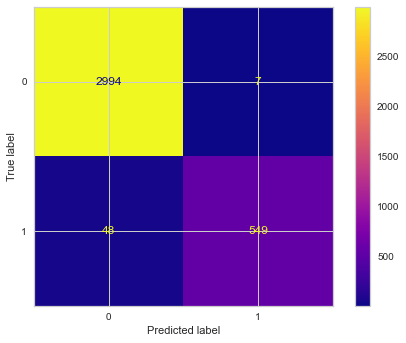

In [187]:
print("GB_tuned")
print ("------------------")
eval(GB_tuned, X_train, X_test)

In [188]:
train_val(y_train, y_train_pred, y_test, y_pred)

,train_set,test_set
Accuracy,0.986,0.985
Precision,0.989,0.987
Recall,0.927,0.920
f1,0.957,0.952


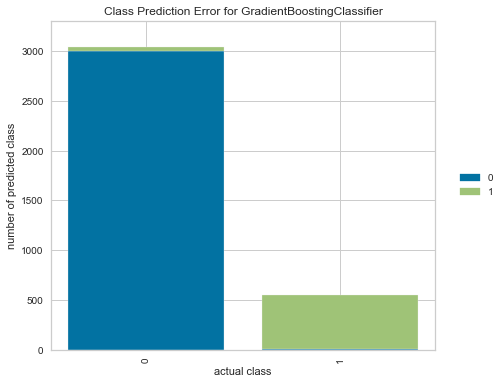

In [189]:
from yellowbrick.classifier import ClassPredictionError

visualizer = ClassPredictionError(GB_tuned)

# Fit the training data to the visualizer
visualizer.fit(X_train, y_train)

# Evaluate the model on the test data
visualizer.score(X_test, y_test)

# Draw visualization
visualizer.poof();

#### Gradient Boosting Classifier ROC (Receiver Operating Curve) and AUC (Area Under Curve)

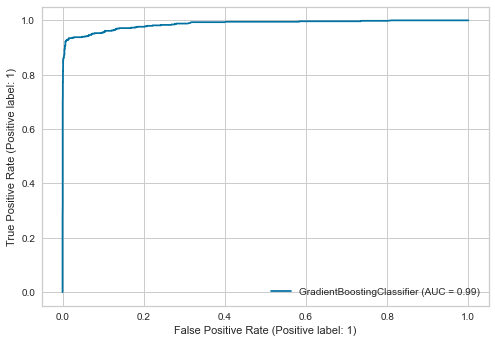

In [190]:
plot_roc_curve(GB_model, X_test, y_test);

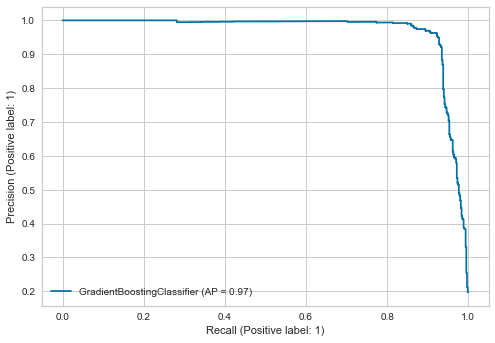

In [191]:
plot_precision_recall_curve(GB_model, X_test, y_test);

#### Prediction

___

### KNeighbors Classifier

#### Model Building

In [192]:
from sklearn.neighbors import KNeighborsClassifier
KNN_model = KNeighborsClassifier(n_neighbors = 5)
KNN_model.fit(X_train, y_train)
y_pred = KNN_model.predict(X_test)
y_train_pred = KNN_model.predict(X_train)

KNN_model_f1 = f1_score(y_test, y_pred)
KNN_model_acc = accuracy_score(y_test, y_pred)
KNN_model_recall = recall_score(y_test, y_pred)
KNN_model_auc = roc_auc_score(y_test, y_pred)

#### Evaluating Model Performance

KNN_Model
------------------
[[2883  118]
 [  83  514]]
Test_Set
              precision    recall  f1-score   support

           0       0.97      0.96      0.97      3001
           1       0.81      0.86      0.84       597

    accuracy                           0.94      3598
   macro avg       0.89      0.91      0.90      3598
weighted avg       0.95      0.94      0.94      3598

Train_Set
              precision    recall  f1-score   support

           0       0.98      0.98      0.98      6999
           1       0.88      0.88      0.88      1394

    accuracy                           0.96      8393
   macro avg       0.93      0.93      0.93      8393
weighted avg       0.96      0.96      0.96      8393



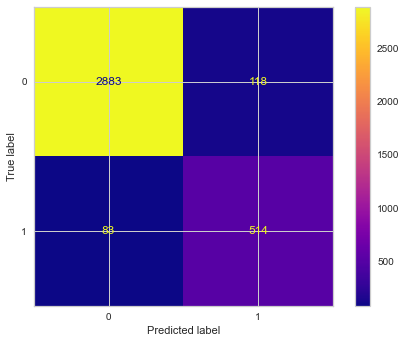

In [193]:
print("KNN_Model")
print ("------------------")
eval(KNN_model, X_train, X_test)

In [194]:
train_val(y_train, y_train_pred, y_test, y_pred)

,train_set,test_set
Accuracy,0.960,0.944
Precision,0.879,0.813
Recall,0.878,0.861
f1,0.879,0.836


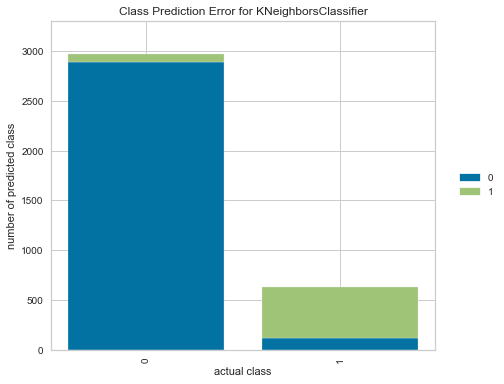

In [195]:
from yellowbrick.classifier import ClassPredictionError

visualizer = ClassPredictionError(KNN_model)

# Fit the training data to the visualizer
visualizer.fit(X_train, y_train)

# Evaluate the model on the test data
visualizer.score(X_test, y_test)

# Draw visualization
visualizer.poof();

#### KNeighbors Classifier Cross Validation

In [196]:
KNN_cv = KNeighborsClassifier(n_neighbors = 5)

KNN_cv_scores = cross_validate(KNN_cv, X_train, y_train, 
                              scoring = ['accuracy', 'precision','recall', 'f1', 'roc_auc'], cv = 10)
KNN_cv_scores = pd.DataFrame(KNN_cv_scores, index = range(1, 11))

KNN_cv_scores.mean()[2:]

test_accuracy    0.948
test_precision   0.835
test_recall      0.859
test_f1          0.846
test_roc_auc     0.943
dtype: float64

#### Elbow Method for Choosing Reasonable K Values

[0.053362979433018376, 0.04307948860478039, 0.053085047248471406, 0.04558087826570312, 0.0558643690939411, 0.05141745414118959, 0.05697609783212898, 0.05669816564758201, 0.06142301278488049, 0.060867148415786554, 0.06475819899944413, 0.06698165647581988, 0.07031684269038352, 0.0714285714285714, 0.07559755419677594, 0.07448582545858806, 0.07809894385769867, 0.07865480822679272, 0.08032240133407453, 0.08282379099499726, 0.08393551973318514, 0.08643690939410786, 0.0861589772095609, 0.08893829905503059, 0.09032795997776544, 0.09088382434685938, 0.0933852140077821, 0.09310728182323513, 0.09366314619232907]


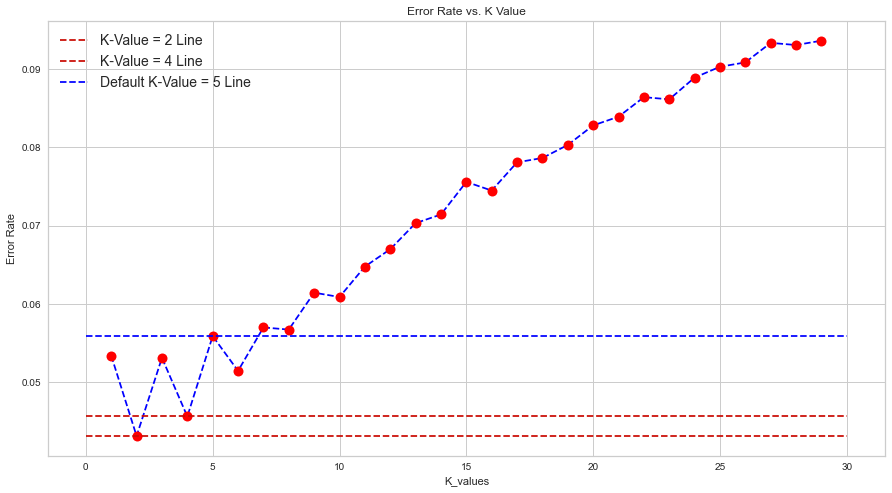

In [197]:
test_error_rates = []

for k in range(1, 30):
    KNN = KNeighborsClassifier(n_neighbors = k)
    KNN.fit(X_train, y_train) 
   
    y_pred = KNN.predict(X_test)
    
    test_error = 1 - accuracy_score(y_test, y_pred)
    test_error_rates.append(test_error)
    
print(test_error_rates)

plt.figure(figsize = (15, 8))
plt.plot(range(1, 30), test_error_rates, color = 'blue', linestyle = '--', marker = 'o',
         markerfacecolor = 'red', markersize = 10)
plt.title('Error Rate vs. K Value')
plt.xlabel('K_values')
plt.ylabel('Error Rate')

plt.hlines(y = 0.04307948860478039, xmin = 0, xmax = 30, colors = 'r', linestyles = "--", label = "K-Value = 2 Line")
plt.hlines(y = 0.04558087826570312, xmin = 0, xmax = 30, colors = 'r', linestyles = "--", label = "K-Value = 4 Line")
plt.hlines(y = 0.055864369093941, xmin = 0, xmax = 30, colors = 'blue', linestyles = "--", label = "Default K-Value = 5 Line")
plt.legend(prop = {"size":14});

In [198]:
# FIRST A QUICK COMPARISON TO OUR DEFAULT K=5

knn5 = KNeighborsClassifier(n_neighbors = 5)

knn5.fit(X_train,y_train)
pred = knn5.predict(X_test)

print('WITH K=5')
print('---------------')
print(confusion_matrix(y_test, pred))
print('---------------')
print(classification_report(y_test, pred))

WITH K=5
---------------
[[2883  118]
 [  83  514]]
---------------
              precision    recall  f1-score   support

           0       0.97      0.96      0.97      3001
           1       0.81      0.86      0.84       597

    accuracy                           0.94      3598
   macro avg       0.89      0.91      0.90      3598
weighted avg       0.95      0.94      0.94      3598



In [199]:
# NOW K=2

knn2 = KNeighborsClassifier(n_neighbors = 2)

knn2.fit(X_train,y_train)
pred = knn2.predict(X_test)

print('WITH K=2')
print('---------------')
print(confusion_matrix(y_test, pred))
print('---------------')
print(classification_report(y_test, pred))

WITH K=2
---------------
[[2951   50]
 [ 105  492]]
---------------
              precision    recall  f1-score   support

           0       0.97      0.98      0.97      3001
           1       0.91      0.82      0.86       597

    accuracy                           0.96      3598
   macro avg       0.94      0.90      0.92      3598
weighted avg       0.96      0.96      0.96      3598



In [200]:
# NOW K=4

knn4 = KNeighborsClassifier(n_neighbors = 4)

knn4.fit(X_train,y_train)
pred = knn4.predict(X_test)

print('WITH K=4')
print('---------------')
print(confusion_matrix(y_test, pred))
print('---------------')
print(classification_report(y_test, pred))

WITH K=4
---------------
[[2929   72]
 [  92  505]]
---------------
              precision    recall  f1-score   support

           0       0.97      0.98      0.97      3001
           1       0.88      0.85      0.86       597

    accuracy                           0.95      3598
   macro avg       0.92      0.91      0.92      3598
weighted avg       0.95      0.95      0.95      3598



In [201]:
# NOW K=6

knn6 = KNeighborsClassifier(n_neighbors = 6)

knn6.fit(X_train,y_train)
pred = knn6.predict(X_test)

print('WITH K=6')
print('---------------')
print(confusion_matrix(y_test, pred))
print('---------------')
print(classification_report(y_test, pred))

WITH K=6
---------------
[[2905   96]
 [  89  508]]
---------------
              precision    recall  f1-score   support

           0       0.97      0.97      0.97      3001
           1       0.84      0.85      0.85       597

    accuracy                           0.95      3598
   macro avg       0.91      0.91      0.91      3598
weighted avg       0.95      0.95      0.95      3598



In [202]:
# NOW K=8

knn8 = KNeighborsClassifier(n_neighbors = 8)

knn8.fit(X_train,y_train)
pred = knn8.predict(X_test)

print('WITH K=8')
print('---------------')
print(confusion_matrix(y_test, pred))
print('---------------')
print(classification_report(y_test, pred))

WITH K=8
---------------
[[2903   98]
 [ 106  491]]
---------------
              precision    recall  f1-score   support

           0       0.96      0.97      0.97      3001
           1       0.83      0.82      0.83       597

    accuracy                           0.94      3598
   macro avg       0.90      0.89      0.90      3598
weighted avg       0.94      0.94      0.94      3598



In [203]:
# NOW K=10

knn10 = KNeighborsClassifier(n_neighbors = 10)

knn10.fit(X_train,y_train)
pred = knn10.predict(X_test)

print('WITH K=10')
print('---------------')
print(confusion_matrix(y_test, pred))
print('---------------')
print(classification_report(y_test, pred))

WITH K=10
---------------
[[2898  103]
 [ 116  481]]
---------------
              precision    recall  f1-score   support

           0       0.96      0.97      0.96      3001
           1       0.82      0.81      0.81       597

    accuracy                           0.94      3598
   macro avg       0.89      0.89      0.89      3598
weighted avg       0.94      0.94      0.94      3598



#### KNeighbors Classifier GridsearchCV for Choosing Reasonable K Values

In [204]:
k_values = range(1, 30)
param_grid = {"n_neighbors": k_values, "p": [1, 2], "weights": ['uniform', "distance"]}

In [206]:
KNN_grid = KNeighborsClassifier()
KNN_grid_model = GridSearchCV(KNN_grid, param_grid, cv = 10, scoring = 'recall')  # scoring RECALL olmalı mı?
KNN_grid_model.fit(X_train, y_train)

# While recall expresses the ability to find all relevant instances in a dataset, 
# precision expresses the proportion of the data points our model says was relevant actually were relevant
# https://towardsdatascience.com/beyond-accuracy-precision-and-recall-3da06bea9f6c

GridSearchCV(cv=10, estimator=KNeighborsClassifier(),
             param_grid={'n_neighbors': range(1, 30), 'p': [1, 2],
                         'weights': ['uniform', 'distance']},
             scoring='recall')

In [207]:
KNN_grid_model.best_estimator_

KNeighborsClassifier(n_neighbors=3, p=1, weights='distance')

In [209]:
print(colored('\033[1mBest Parameters of GridSearchCV for KNN Model:\033[0m', 'blue'), colored(KNN_grid_model.best_params_, 'green'))
print("--------------------------------------------------------------------------------------------------------------------")
print(colored('\033[1mBest Estimator of GridSearchCV for KNN Model:\033[0m', 'blue'), colored(KNN_grid_model.best_estimator_, 'green'))

Best Parameters of GridSearchCV for KNN Model: {'n_neighbors': 3, 'p': 1, 'weights': 'distance'}
--------------------------------------------------------------------------------------------------------------------
Best Estimator of GridSearchCV for KNN Model: KNeighborsClassifier(n_neighbors=3, p=1, weights='distance')


KNN_tuned (K=3)
------------------
[[2897  104]
 [  79  518]]
Test_Set
              precision    recall  f1-score   support

           0       0.97      0.97      0.97      3001
           1       0.83      0.87      0.85       597

    accuracy                           0.95      3598
   macro avg       0.90      0.92      0.91      3598
weighted avg       0.95      0.95      0.95      3598

Train_Set
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      6999
           1       1.00      1.00      1.00      1394

    accuracy                           1.00      8393
   macro avg       1.00      1.00      1.00      8393
weighted avg       1.00      1.00      1.00      8393



,train_set,test_set
Accuracy,1.000,0.949
Precision,1.000,0.833
Recall,1.000,0.868
f1,1.000,0.850


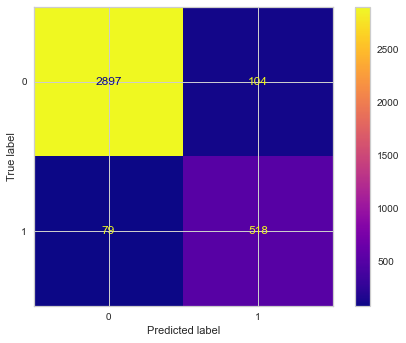

In [210]:
# NOW WITH K=3

KNN_tuned3 = KNeighborsClassifier(n_neighbors = 3, p = 1, weights='distance')
KNN_tuned3.fit(X_train, y_train)
y_pred = KNN_tuned3.predict(X_test)
y_train_pred = KNN_tuned3.predict(X_train)

KNN_tuned3_f1 = f1_score(y_test, y_pred)
KNN_tuned3_acc = accuracy_score(y_test, y_pred)
KNN_tuned3_recall = recall_score(y_test, y_pred)
KNN_tuned3_auc = roc_auc_score(y_test, y_pred)

print("KNN_tuned (K=3)")
print ("------------------")
eval(KNN_tuned3, X_train, X_test)
train_val(y_train, y_train_pred, y_test, y_pred)

KNN_tuned (K=1)
------------------
[[2896  105]
 [  87  510]]
Test_Set
              precision    recall  f1-score   support

           0       0.97      0.97      0.97      3001
           1       0.83      0.85      0.84       597

    accuracy                           0.95      3598
   macro avg       0.90      0.91      0.90      3598
weighted avg       0.95      0.95      0.95      3598

Train_Set
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      6999
           1       1.00      1.00      1.00      1394

    accuracy                           1.00      8393
   macro avg       1.00      1.00      1.00      8393
weighted avg       1.00      1.00      1.00      8393



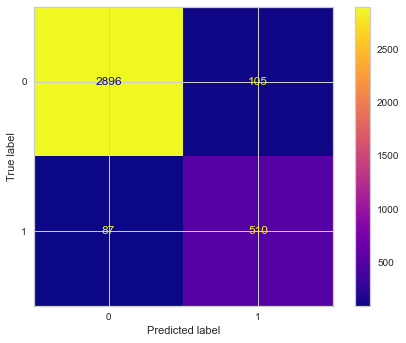

In [211]:
# NOW WITH K=1

KNN_tuned1 = KNeighborsClassifier(n_neighbors = 1)
KNN_tuned1.fit(X_train, y_train)
y_pred = KNN_tuned1.predict(X_test)
y_train_pred = KNN_tuned1.predict(X_train)

KNN_tuned1_f1 = f1_score(y_test, y_pred)
KNN_tuned1_acc = accuracy_score(y_test, y_pred)
KNN_tuned1_recall = recall_score(y_test, y_pred)
KNN_tuned1_auc = roc_auc_score(y_test, y_pred)

print("KNN_tuned (K=1)")
print ("------------------")
eval(KNN_tuned1, X_train, X_test)

In [212]:
#  n_neighbors: 3 , 1 gives approximate scores. Should we choose K=1 for KKN_tuned to decrease the level of complexity?

#### KNeighbors Classifier ROC (Receiver Operating Curve) and AUC (Area Under Curve)

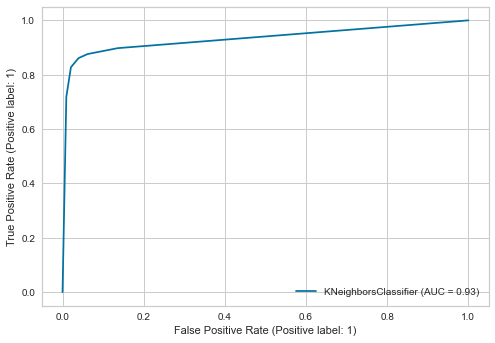

In [213]:
plot_roc_curve(KNN_model, X_test, y_test);

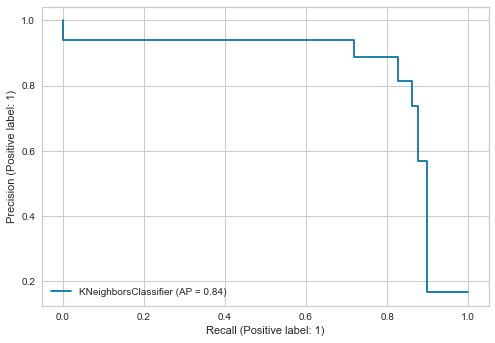

In [214]:
plot_precision_recall_curve(KNN_model, X_test, y_test);

#### Prediction

___

### Random Forest Classifier

#### Model Building

In [215]:
from sklearn.ensemble import RandomForestClassifier
RF_model = RandomForestClassifier(class_weight = "balanced", random_state = 101)
RF_model.fit(X_train, y_train)
y_pred = RF_model.predict(X_test)
y_train_pred = RF_model.predict(X_train)

RF_f1 = f1_score(y_test, y_pred)
RF_acc = accuracy_score(y_test, y_pred)
RF_recall = recall_score(y_test, y_pred)
RF_auc = roc_auc_score(y_test, y_pred)

#### Evaluating Model Performance

RF_Model
------------------
[[2996    5]
 [  56  541]]
Test_Set
              precision    recall  f1-score   support

           0       0.98      1.00      0.99      3001
           1       0.99      0.91      0.95       597

    accuracy                           0.98      3598
   macro avg       0.99      0.95      0.97      3598
weighted avg       0.98      0.98      0.98      3598

Train_Set
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      6999
           1       1.00      1.00      1.00      1394

    accuracy                           1.00      8393
   macro avg       1.00      1.00      1.00      8393
weighted avg       1.00      1.00      1.00      8393



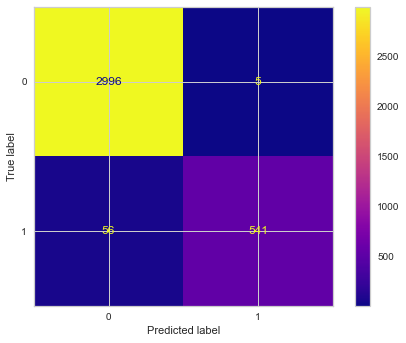

In [216]:
print("RF_Model")
print ("------------------")
eval(RF_model, X_train, X_test)

In [217]:
train_val(y_train, y_train_pred, y_test, y_pred)

,train_set,test_set
Accuracy,1.000,0.983
Precision,1.000,0.991
Recall,1.000,0.906
f1,1.000,0.947


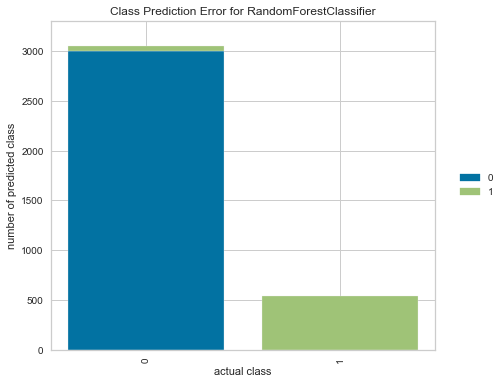

In [218]:
from yellowbrick.classifier import ClassPredictionError

visualizer = ClassPredictionError(RF_model)

# Fit the training data to the visualizer
visualizer.fit(X_train, y_train)

# Evaluate the model on the test data
visualizer.score(X_test, y_test)

# Draw visualization
visualizer.poof();

#### Feature Importance for Random Forest Model

In [219]:
RF_feature_imp = pd.DataFrame(index=X.columns, data = RF_model.feature_importances_, columns = ['Importance']).sort_values("Importance", ascending = False)
RF_feature_imp

,Importance
satisfaction_level,0.282
time_spend_company,0.233
average_montly_hours,0.155
last_evaluation,0.147
number_project,0.136
work_accident,0.012
salary_low,0.007
salary_medium,0.005
departments_sales,0.004
departments_technical,0.004


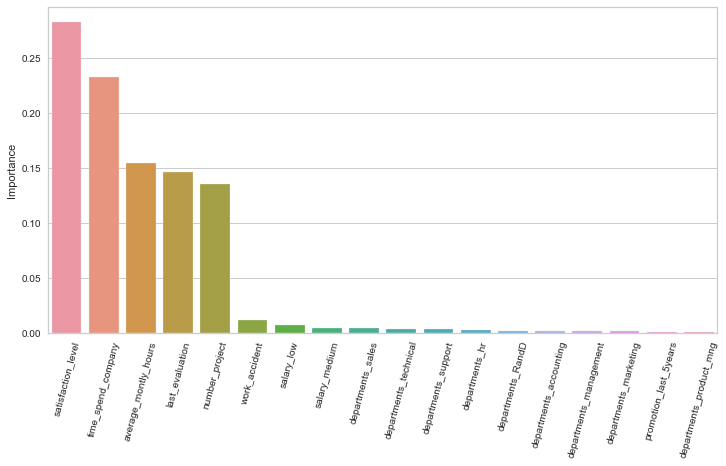

In [220]:
plt.figure(figsize = (12,6))
sns.barplot(data = RF_feature_imp.sort_values('Importance', ascending = False), x = RF_feature_imp.sort_values('Importance', ascending = False).index, y = 'Importance')
plt.xticks(rotation = 75);

#### Random Forest Classifier Cross Validation

In [221]:
RF_cv = RandomForestClassifier(class_weight = "balanced", random_state = 101)

RF_cv_scores = cross_validate(RF_cv, X_train, y_train, 
                              scoring = ['accuracy', 'precision','recall', 'f1', 'roc_auc'], cv = 10)
RF_cv_scores = pd.DataFrame(RF_cv_scores, index = range(1, 11))

RF_cv_scores.mean()[2:]

test_accuracy    0.982
test_precision   0.982
test_recall      0.906
test_f1          0.942
test_roc_auc     0.981
dtype: float64

#### Random Forest Classifier GridSearchCV

In [222]:
param_grid = {'n_estimators' : [50, 100, 300],
             'max_features' : [2, 3, 4],
             'max_depth' : [3, 5, 7, 9],
             'min_samples_split' : [2, 5, 8]}

In [223]:
RF_grid = RandomForestClassifier(class_weight = 'balanced', random_state = 101)
RF_grid_model = GridSearchCV(estimator = RF_grid, 
                             param_grid = param_grid, 
                             scoring = "recall", 
                             n_jobs = -1, verbose = 2)
RF_grid_model.fit(X_train, y_train)

Fitting 5 folds for each of 108 candidates, totalling 540 fits


GridSearchCV(estimator=RandomForestClassifier(class_weight='balanced',
                                              random_state=101),
             n_jobs=-1,
             param_grid={'max_depth': [3, 5, 7, 9], 'max_features': [2, 3, 4],
                         'min_samples_split': [2, 5, 8],
                         'n_estimators': [50, 100, 300]},
             scoring='recall', verbose=2)

In [224]:
RF_grid_model.best_estimator_

RandomForestClassifier(class_weight='balanced', max_depth=3, max_features=4,
                       n_estimators=300, random_state=101)

In [226]:
print(colored('\033[1mBest Parameters of GridSearchCV for Random Forest Model:\033[0m', 'blue'), colored(RF_grid_model.best_params_, 'green'))
print("--------------------------------------------------------------------------------------------------------------------")
print(colored('\033[1mBest Estimator of GridSearchCV for Random Forest Model:\033[0m', 'blue'), colored(RF_grid_model.best_estimator_, 'green'))

Best Parameters of GridSearchCV for Random Forest Model: {'max_depth': 3, 'max_features': 4, 'min_samples_split': 2, 'n_estimators': 300}
--------------------------------------------------------------------------------------------------------------------
Best Estimator of GridSearchCV for Random Forest Model: RandomForestClassifier(class_weight='balanced', max_depth=3, max_features=4,
                       n_estimators=300, random_state=101)


In [227]:
RF_tuned = RandomForestClassifier(class_weight = 'balanced',
                                  max_depth = 3,
                                  max_features = 4,
                                  n_estimators = 300,
                                  random_state = 101).fit(X_train, y_train)

In [228]:
y_pred = RF_tuned.predict(X_test)
y_train_pred = RF_tuned.predict(X_train)

RF_tuned_f1 = f1_score(y_test, y_pred)
RF_tuned_acc = accuracy_score(y_test, y_pred)
RF_tuned_recall = recall_score(y_test, y_pred)
RF_tuned_auc = roc_auc_score(y_test, y_pred)

RF_tuned
------------------
[[2804  197]
 [  47  550]]
Test_Set
              precision    recall  f1-score   support

           0       0.98      0.93      0.96      3001
           1       0.74      0.92      0.82       597

    accuracy                           0.93      3598
   macro avg       0.86      0.93      0.89      3598
weighted avg       0.94      0.93      0.94      3598

Train_Set
              precision    recall  f1-score   support

           0       0.99      0.93      0.96      6999
           1       0.73      0.94      0.82      1394

    accuracy                           0.93      8393
   macro avg       0.86      0.93      0.89      8393
weighted avg       0.94      0.93      0.94      8393



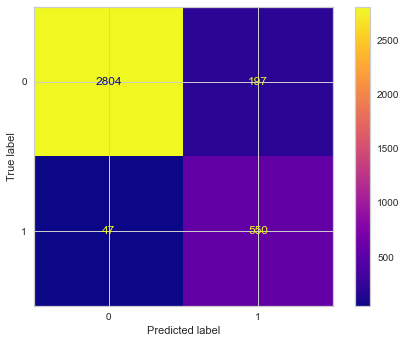

In [229]:
print("RF_tuned")
print ("------------------")
eval(RF_tuned, X_train, X_test)

In [230]:
train_val(y_train, y_train_pred, y_test, y_pred)

,train_set,test_set
Accuracy,0.932,0.932
Precision,0.731,0.736
Recall,0.937,0.921
f1,0.821,0.818


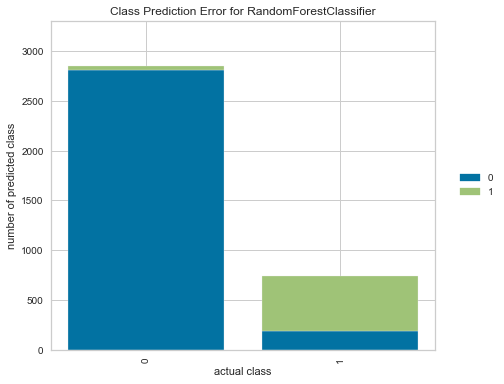

In [231]:
from yellowbrick.classifier import ClassPredictionError

visualizer = ClassPredictionError(RF_tuned)

# Fit the training data to the visualizer
visualizer.fit(X_train, y_train)

# Evaluate the model on the test data
visualizer.score(X_test, y_test)

# Draw visualization
visualizer.poof();

#### Random Forest Classifier ROC (Receiver Operating Curve) and AUC (Area Under Curve)

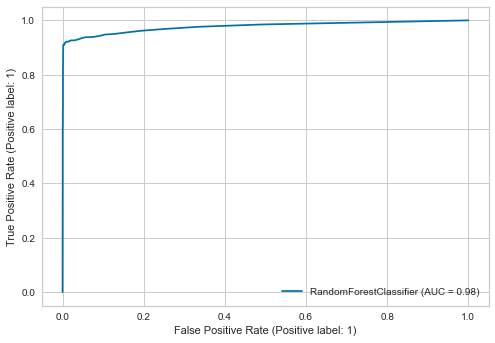

In [232]:
plot_roc_curve(RF_model, X_test, y_test);

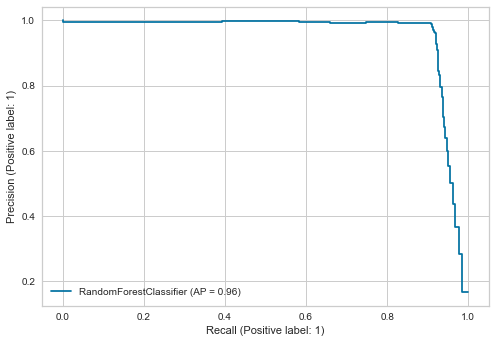

In [233]:
plot_precision_recall_curve(RF_model, X_test, y_test);

#### Prediction

___

### CatBoost Classifier

In [236]:
# !pip install catboost
# !pip install lightgbm
# !pip install xgboost

#### Model Building

In [251]:
from catboost import CatBoostClassifier
from lightgbm import LGBMClassifier
from xgboost import XGBRegressor, XGBClassifier, plot_importance

CB_model = CatBoostClassifier(verbose = False, scale_pos_weight = 4, random_state = 101)
CB_model.fit(X_train, y_train)
y_pred = CB_model.predict(X_test)
y_train_pred = CB_model.predict(X_train)

CB_model_f1 = f1_score(y_test, y_pred)
CB_model_acc = accuracy_score(y_test, y_pred)
CB_model_recall = recall_score(y_test, y_pred)
CB_model_auc = roc_auc_score(y_test, y_pred)

#### Evaluating Model Performance

CB_Model
------------------
[[2977   24]
 [  47  550]]
Test_Set
              precision    recall  f1-score   support

           0       0.98      0.99      0.99      3001
           1       0.96      0.92      0.94       597

    accuracy                           0.98      3598
   macro avg       0.97      0.96      0.96      3598
weighted avg       0.98      0.98      0.98      3598

Train_Set
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      6999
           1       0.98      0.99      0.98      1394

    accuracy                           0.99      8393
   macro avg       0.99      0.99      0.99      8393
weighted avg       0.99      0.99      0.99      8393



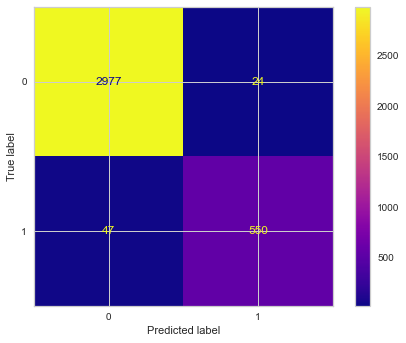

In [252]:
print("CB_Model")
print ("------------------")
eval(CB_model, X_train, X_test)

In [253]:
train_val(y_train, y_train_pred, y_test, y_pred)

,train_set,test_set
Accuracy,0.994,0.980
Precision,0.977,0.958
Recall,0.987,0.921
f1,0.982,0.939


In [254]:
# from yellowbrick.classifier import ClassPredictionError

# visualizer = ClassPredictionError(CB_model)

# Fit the training data to the visualizer
# visualizer.fit(X_train, y_train)

# # Evaluate the model on the test data
# visualizer.score(X_test, y_test)

# # Draw visualization
# visualizer.poof();

**FOR SOME REASON THE USUAL ABOVE YELLOWBRICK CLASSPREDICTIONERROR CODE GAVE AN ERROR, SO THE BELOW CODE WITH A WRAP ADDITION WORKED**

https://www.scikit-yb.org/en/latest/api/contrib/wrapper.html?highlight=Third%20party

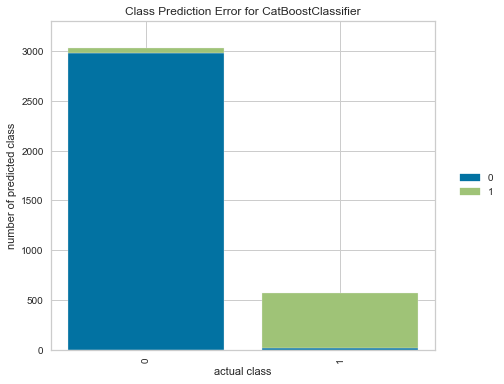

In [256]:
from yellowbrick.classifier import ClassPredictionError
from yellowbrick.contrib.wrapper import wrap

model = wrap(CB_model)
visualizer = ClassPredictionError(model)

visualizer.fit(X_train, y_train)
visualizer.score(X_test, y_test)
visualizer.poof();

#### Feature Importance for CatBoost Model

In [257]:
CB_feature_imp = pd.DataFrame(index = X.columns, data = CB_model.feature_importances_, columns = ['Importance']).sort_values("Importance", ascending = False)
CB_feature_imp

,Importance
satisfaction_level,26.423
time_spend_company,20.504
number_project,15.951
average_montly_hours,14.938
last_evaluation,13.180
salary_low,1.730
work_accident,1.684
salary_medium,1.175
departments_support,0.892
departments_sales,0.886


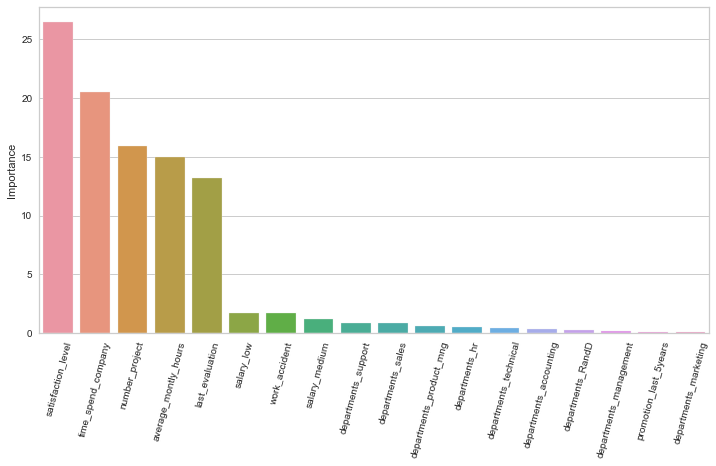

In [258]:
plt.figure(figsize = (12,6))
sns.barplot(data = CB_feature_imp.sort_values('Importance', ascending = False), x = CB_feature_imp.sort_values('Importance', ascending = False).index, y = 'Importance')
plt.xticks(rotation = 75);

#### CatBoost Classifier Cross Validation

In [259]:
CB_cv = CatBoostClassifier(verbose = False, scale_pos_weight = 4, random_state = 101)

CB_cv_scores = cross_validate(CB_cv, X_train, y_train, 
                              scoring = ['accuracy', 'precision','recall', 'f1', 'roc_auc'], cv = 10)
CB_cv_scores = pd.DataFrame(CB_cv_scores, index = range(1, 11))

CB_cv_scores.mean()[2:]

test_accuracy    0.980
test_precision   0.952
test_recall      0.924
test_f1          0.938
test_roc_auc     0.983
dtype: float64

#### CatBoost Classifier GridSearchCV

In [264]:
param_grid = {'learning_rate': [0.01, 0.03, 0.1, 0.5],
              'depth': [4, 6, 8, 10],
              'l2_leaf_reg': [1, 3, 5, 7, 9]}

In [265]:
CB_grid = CatBoostClassifier(verbose = False, scale_pos_weight = 4, random_state = 101)
CB_grid_model = GridSearchCV(estimator = CB_grid, 
                             param_grid = param_grid, 
                             scoring = "recall", 
                             n_jobs = -1, verbose = 2)
CB_grid_model.fit(X_train, y_train)

Fitting 5 folds for each of 80 candidates, totalling 400 fits


GridSearchCV(estimator=<catboost.core.CatBoostClassifier object at 0x000001F0692F0340>,
             n_jobs=-1,
             param_grid={'depth': [4, 6, 8, 10], 'l2_leaf_reg': [1, 3, 5, 7, 9],
                         'learning_rate': [0.01, 0.03, 0.1, 0.5]},
             scoring='recall', verbose=2)

In [266]:
CB_grid_model.best_params_

{'depth': 4, 'l2_leaf_reg': 3, 'learning_rate': 0.01}

In [267]:
print(colored('\033[1mBest Parameters of GridSearchCV for Random Forest Model:\033[0m', 'blue'), colored(CB_grid_model.best_params_, 'green'))

Best Parameters of GridSearchCV for Random Forest Model: {'depth': 4, 'l2_leaf_reg': 3, 'learning_rate': 0.01}


In [268]:
CB_tuned = CatBoostClassifier(verbose = False, 
                              scale_pos_weight = 4,
                              depth = 4,
                              l2_leaf_reg = 3,
                              learning_rate = 0.01,
                              random_state = 101).fit(X_train, y_train)      

In [269]:
y_pred = CB_tuned.predict(X_test)
y_train_pred = CB_tuned.predict(X_train)

CB_tuned_f1 = f1_score(y_test, y_pred)
CB_tuned_acc = accuracy_score(y_test, y_pred)
CB_tuned_recall = recall_score(y_test, y_pred)
CB_tuned_auc = roc_auc_score(y_test, y_pred)

CB_tuned
------------------
[[2946   55]
 [  45  552]]
Test_Set
              precision    recall  f1-score   support

           0       0.98      0.98      0.98      3001
           1       0.91      0.92      0.92       597

    accuracy                           0.97      3598
   macro avg       0.95      0.95      0.95      3598
weighted avg       0.97      0.97      0.97      3598

Train_Set
              precision    recall  f1-score   support

           0       0.99      0.98      0.99      6999
           1       0.92      0.94      0.93      1394

    accuracy                           0.98      8393
   macro avg       0.96      0.96      0.96      8393
weighted avg       0.98      0.98      0.98      8393



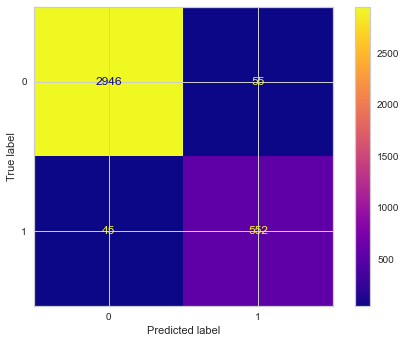

In [270]:
print("CB_tuned")
print ("------------------")
eval(CB_tuned, X_train, X_test)

In [271]:
train_val(y_train, y_train_pred, y_test, y_pred)

,train_set,test_set
Accuracy,0.977,0.972
Precision,0.923,0.909
Recall,0.940,0.925
f1,0.931,0.917


In [273]:
# from yellowbrick.classifier import ClassPredictionError

# visualizer = ClassPredictionError(CB_tuned)

# # Fit the training data to the visualizer
# visualizer.fit(X_train, y_train)

# # Evaluate the model on the test data
# visualizer.score(X_test, y_test)

# # Draw visualization
# visualizer.poof();

**FOR SOME REASON THE USUAL ABOVE YELLOWBRICK CLASSPREDICTIONERROR CODE GAVE AN ERROR, SO THE BELOW CODE WITH A WRAP ADDITION WORKED**

https://www.scikit-yb.org/en/latest/api/contrib/wrapper.html?highlight=Third%20party

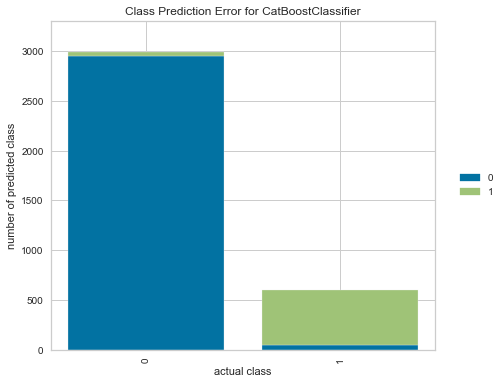

In [274]:
from yellowbrick.classifier import ClassPredictionError
from yellowbrick.contrib.wrapper import wrap

model = wrap(CB_tuned)
visualizer = ClassPredictionError(model)

visualizer.fit(X_train, y_train)
visualizer.score(X_test, y_test)
visualizer.poof();

#### CatBoost Classifier ROC (Receiver Operating Curve) and AUC (Area Under Curve)

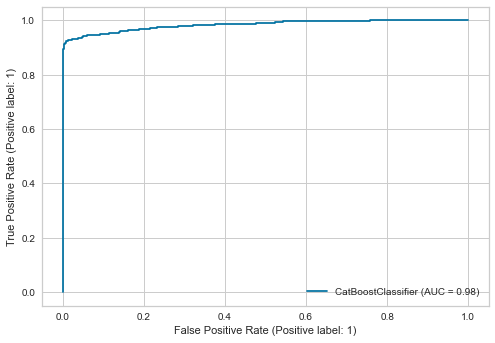

In [275]:
plot_roc_curve(CB_model, X_test, y_test);

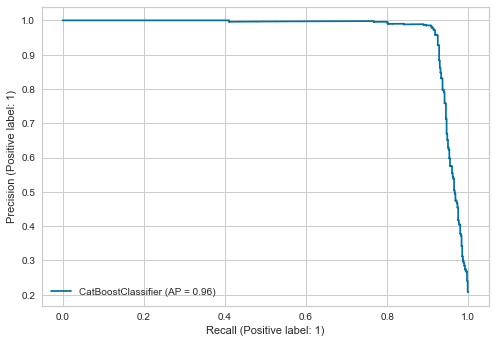

In [276]:
plot_precision_recall_curve(CB_model, X_test, y_test);

#### Prediction

___

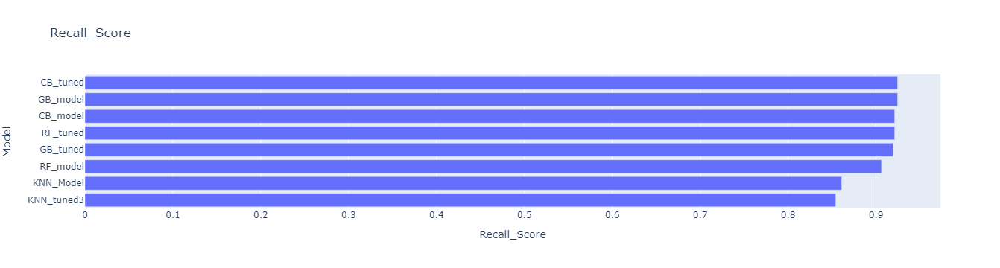

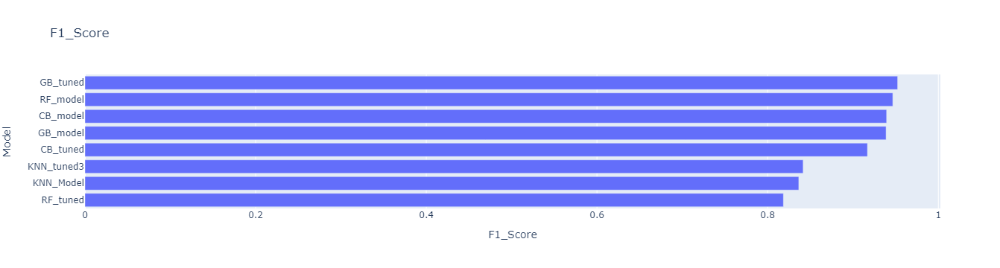

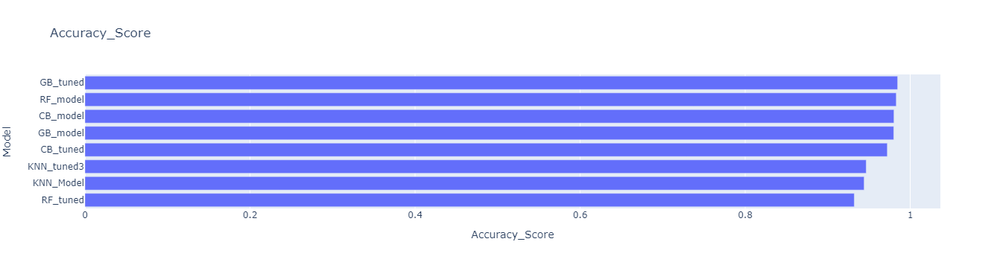

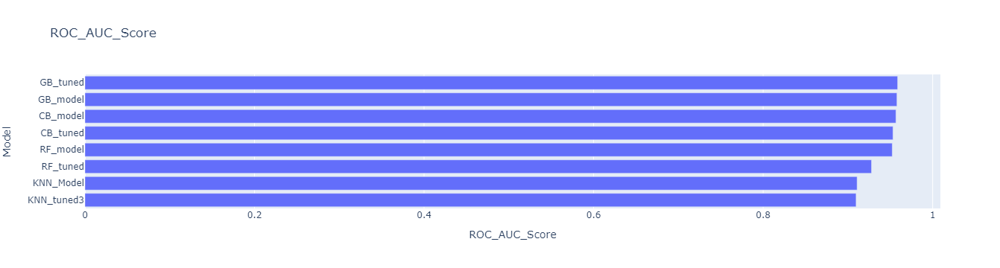

In [277]:
compare = pd.DataFrame({"Model": ["GB_model", "GB_tuned", "KNN_Model", "KNN_tuned3", "RF_model", "RF_tuned", "CB_model", 
                                  "CB_tuned"],
                        
                        "F1_Score": [GB_model_f1, GB_tuned_f1, KNN_model_f1, KNN_tuned1_f1, RF_f1, RF_tuned_f1, 
                                     CB_model_f1, CB_tuned_f1],
                                                 
                        "Accuracy_Score": [GB_model_acc, GB_tuned_acc, KNN_model_acc, KNN_tuned1_acc, RF_acc, 
                                           RF_tuned_acc, CB_model_acc, CB_tuned_acc],
                        
                        "Recall_Score": [GB_model_recall, GB_tuned_recall, KNN_model_recall, KNN_tuned1_recall, RF_recall, 
                                     RF_tuned_recall, CB_model_recall, CB_tuned_recall],
                       
                        "ROC_AUC_Score": [GB_model_auc, GB_tuned_auc, KNN_model_auc, KNN_tuned1_auc, RF_auc, 
                                          RF_tuned_auc, CB_model_auc, CB_tuned_auc]})

compare = compare.sort_values(by="Recall_Score", ascending=True)
fig = px.bar(compare, x = "Recall_Score", y = "Model", title = "Recall_Score")
fig.show()

compare = compare.sort_values(by="F1_Score", ascending=True)
fig = px.bar(compare, x = "F1_Score", y = "Model", title = "F1_Score")
fig.show()

compare = compare.sort_values(by="Accuracy_Score", ascending=True)
fig = px.bar(compare, x = "Accuracy_Score", y = "Model", title = "Accuracy_Score")
fig.show()

compare = compare.sort_values(by="ROC_AUC_Score", ascending=True)
fig = px.bar(compare, x = "ROC_AUC_Score", y = "Model", title = "ROC_AUC_Score")
fig.show()

## 6. Model Deployement

Model Deployement helps us showcase our work to the world and make better decisions with it. But, deploying a model can get a little tricky at times. Before deploying the model, many things such as data storage, preprocessing, model building and monitoring need to be studied. Streamlit is a popular open source framework used by data scientists for model distribution.

Deployment of machine learning models, means making our models available to our other business systems. By deploying models, other systems can send data to them and get their predictions, which are in turn populated back into the company systems. Through machine learning model deployment, can begin to take full advantage of the model we built.

Data science is concerned with how to build machine learning models, which algorithm is more predictive, how to design features, and what variables to use to make the models more accurate. However, how these models are actually used is often neglected. And yet this is the most important step in the machine learning pipeline. Only when a model is fully integrated with the business systems, real values ​​can be extract from its predictions.

After doing the following operations in this notebook, we jump to new .py file and create our web app with Streamlit.

### Save and Export the Model as .pkl

In [279]:
import pickle

In [280]:
gradient_boosting_classifier = pickle.dump(GB_tuned, open('gradient_boosting_model.pkl', 'wb'))

In [281]:
kneighbors_classifier = pickle.dump(KNN_tuned3, open('kneighbors_model.pkl', 'wb'))

In [282]:
random_forest_classifier = pickle.dump(RF_tuned, open('random_forest_model.pkl', 'wb'))

In [283]:
catboost_classifier = pickle.dump(CB_tuned, open('catboost_model.pkl', 'wb'))

In [284]:
X

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,departments_RandD,departments_accounting,departments_hr,departments_management,departments_marketing,departments_product_mng,departments_sales,departments_support,departments_technical,salary_low,salary_medium
0,0.380,0.530,2,157,3,0,0,0,0,0,0,0,0,1,0,0,1,0
1,0.800,0.860,5,262,6,0,0,0,0,0,0,0,0,1,0,0,0,1
2,0.110,0.880,7,272,4,0,0,0,0,0,0,0,0,1,0,0,0,1
3,0.720,0.870,5,223,5,0,0,0,0,0,0,0,0,1,0,0,1,0
4,0.370,0.520,2,159,3,0,0,0,0,0,0,0,0,1,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11995,0.900,0.550,3,259,10,1,1,0,0,0,1,0,0,0,0,0,0,0
11996,0.740,0.950,5,266,10,0,1,0,0,0,1,0,0,0,0,0,0,0
11997,0.850,0.540,3,185,10,0,1,0,0,0,1,0,0,0,0,0,0,0
11998,0.330,0.650,3,172,10,0,1,0,0,0,0,1,0,0,0,0,0,0


In [285]:
col_lst = ['satisfaction_level', 'last_evaluation', 'number_project', 'average_montly_hours', 'time_spend_company', 'work_accident',\
	       'promotion_last_5years', 'departments_RandD', 'departments_accounting', 'departments_hr', 'departments_management',\
		   'departments_marketing', 'departments_product_mng', 'departments_sales', 'departments_support', 'departments_technical',\
		   'salary_low', 'salary_medium']

In [286]:
scaler = MinMaxScaler()
scaler

MinMaxScaler()

In [288]:
df2[col_lst]

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,departments_RandD,departments_accounting,departments_hr,departments_management,departments_marketing,departments_product_mng,departments_sales,departments_support,departments_technical,salary_low,salary_medium
0,0.380,0.530,2,157,3,0,0,0,0,0,0,0,0,1,0,0,1,0
1,0.800,0.860,5,262,6,0,0,0,0,0,0,0,0,1,0,0,0,1
2,0.110,0.880,7,272,4,0,0,0,0,0,0,0,0,1,0,0,0,1
3,0.720,0.870,5,223,5,0,0,0,0,0,0,0,0,1,0,0,1,0
4,0.370,0.520,2,159,3,0,0,0,0,0,0,0,0,1,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11995,0.900,0.550,3,259,10,1,1,0,0,0,1,0,0,0,0,0,0,0
11996,0.740,0.950,5,266,10,0,1,0,0,0,1,0,0,0,0,0,0,0
11997,0.850,0.540,3,185,10,0,1,0,0,0,1,0,0,0,0,0,0,0
11998,0.330,0.650,3,172,10,0,1,0,0,0,0,1,0,0,0,0,0,0


In [289]:
scaler_fitted = scaler.fit(df2[col_lst])
scaler_fitted

MinMaxScaler()

In [290]:
scaler_deploy = pickle.dump(scaler_fitted, open('scaler.pkl', 'wb'))
scaler_deploy

### Save and Export Variables as .pkl

In [291]:
coll_dict = {'satisfaction_level':0.2, 'last_evaluation':0.3, 'number_project':10,\
			 'average_montly_hours':2000, 'time_spend_company':22, 'work_accident':0,\
			 'promotion_last_5years':1, 'departments': 'hr', 'salary':'high'}
coll_dict

{'satisfaction_level': 0.2,
 'last_evaluation': 0.3,
 'number_project': 10,
 'average_montly_hours': 2000,
 'time_spend_company': 22,
 'work_accident': 0,
 'promotion_last_5years': 1,
 'departments': 'hr',
 'salary': 'high'}

In [292]:
columns = ['satisfaction_level', 'last_evaluation', 'number_project', 'average_montly_hours', 'time_spend_company', 'work_accident',\
	       'promotion_last_5years', 'departments_RandD', 'departments_accounting', 'departments_hr', 'departments_management',\
		   'departments_marketing', 'departments_product_mng', 'departments_sales', 'departments_support', 'departments_technical',\
		   'salary_low', 'salary_medium']
columns

['satisfaction_level',
 'last_evaluation',
 'number_project',
 'average_montly_hours',
 'time_spend_company',
 'work_accident',
 'promotion_last_5years',
 'departments_RandD',
 'departments_accounting',
 'departments_hr',
 'departments_management',
 'departments_marketing',
 'departments_product_mng',
 'departments_sales',
 'departments_support',
 'departments_technical',
 'salary_low',
 'salary_medium']

In [293]:
df_coll = pd.DataFrame.from_dict([coll_dict])
df_coll

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,departments,salary
0,0.200,0.300,10,2000,22,0,1,hr,high


In [295]:
X = pd.get_dummies(df_coll).reindex(columns=columns, fill_value=0)
X

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,departments_RandD,departments_accounting,departments_hr,departments_management,departments_marketing,departments_product_mng,departments_sales,departments_support,departments_technical,salary_low,salary_medium
0,0.200,0.300,10,2000,22,0,1,0,0,1,0,0,0,0,0,0,0,0


In [296]:
scaler = pickle.load(open('scaler.pkl', 'rb'))
scaler

MinMaxScaler()

In [297]:
scaled_data = scaler.transform(X)
scaled_data

array([[ 0.12087912, -0.09375   ,  1.6       ,  8.89719626,  2.5       ,
         0.        ,  1.        ,  0.        ,  0.        ,  1.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ]])

In [298]:
model = pickle.load(open('kneighbors_model.pkl', 'rb'))

In [299]:
prediction = model.predict(scaled_data)
prediction

array([0], dtype=int64)